# Analysis of temperature and salinity data from NEMO/VIKING20X model
- Loading monthly data from /vortex/clidex directory
- Hovmoeller-Plots for pure data
- Hovmoeller-Plots without seasonal cycle (anomalies)
- Definition of time periods of composites of decadal variability
- TS-Plots in composites

In [1]:
#Import Packages

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np 
import math
import matplotlib.font_manager
import cmocean as cmo
from tqdm import tqdm
import cartopy.crs as ccrs
import os
from matplotlib import colors
from matplotlib.animation import FuncAnimation 

#Ignore warnings for now
import warnings
warnings.filterwarnings('ignore')

#Local path to respository (Change to your directory for code to work)
path_rp = '/home/milon.miah/Documents/'

os.chdir(path_rp + 'DV_NAshelf_NEMO/Scripts')
from worldmap import WorldMap
from calc import *
from util import *
os.chdir(path_rp)


## Load Data

In [2]:
#Useful list of string with mask names 
masks = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'Southern MAB', 'Northern MAB',
         'Georges Bank', 'Western GoM', 'Eastern GoM', 'Western SS', 
         'Eastern SS', 'Southern GSL', 'Northern GSL', 
         'NFL Shelf', 'Northern NFL Shelf', 'Labrador Shelf1', 'Labrador Shelf2']

In [3]:
#Create dictionaries with temperature and salinity data grouped by masks
ds_temp_masks = {}
ds_sal_masks = {}

#Cut off depth if desired, otherwise put None
depth = 300

for i in range(len(masks)):
    
    #Read temperature masks data from created files on /mnt/data directory of work station 
    ds_temp_masks[masks[i]] = xr.open_dataset('/mnt/data/Temp_Masks/temp_' + masks[i] + '.nc')
    ds_sal_masks[masks[i]] = xr.open_dataset('/mnt/data/Sal_Masks/sal_' + masks[i] + '.nc')
    
    if depth != None:
        ds_temp_masks[masks[i]] = ds_temp_masks[masks[i]].sel(deptht = slice(0, depth))
        ds_sal_masks[masks[i]] = ds_sal_masks[masks[i]].sel(deptht = slice(0, depth))

## Spatial (weighted) averages 

In [4]:
#Load meshgrid data to consider its shape for spatial averaging of physical properties
ds_mesh = xr.open_dataset('/vortex/clidex/data/NEMO/VIKING20X/mesh_mask_viking.nc')
#Load spatial data of defined boxes (Necessary for masked weight data)
ds_masks = xr.open_dataset('/vortex/clidex/data/NEMO/VIKING20X/ecomasks_viking.nc')

In [5]:
#Extract weights of grid cell out of meshgrid data
weights = np.squeeze(ds_mesh.e1t*ds_mesh.e2t)

#Create dictionary of weighted masks (3D information important!)
ds_wei = {}
for i in tqdm(range(len(masks))):
    
    #Apply mask on weights array
    ds_wei[masks[i]] = (weights * ds_masks[masks[i]]).where(np.isnan(ds_masks[masks[i]]) != True, drop = True)
    
    #Cut out weights on land masses (use temperature data to identify shelf)
    ds_wei[masks[i]] = ds_temp_masks[masks[i]].where(np.isnan(ds_temp_masks[masks[i]]), ds_wei[masks[i]])['votemper'][0]
    ds_wei[masks[i]].name = masks[i]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:28<00:00,  1.38s/it]


In [6]:
#Create dictionaries with mean and standard deviation of temperature and salinity in each mask
temp_mean = {}
temp_std = {}
sal_mean = {}
sal_std = {}

for i in tqdm(range(len(masks))):

    #Calculate weighted mean and corresponding standard deviation with module calc.py
    temp_mean[masks[i]], temp_std[masks[i]] = mean_weighted(ds_temp_masks[masks[i]], dim = ['y', 'x'], weights = ds_wei[masks[i]])
    sal_mean[masks[i]], sal_std[masks[i]] = mean_weighted(ds_sal_masks[masks[i]], dim = ['y', 'x'], weights = ds_wei[masks[i]])   

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [02:48<00:00,  8.01s/it]


# Hovmoeller-T/S-Plots for each mask
## Temperature

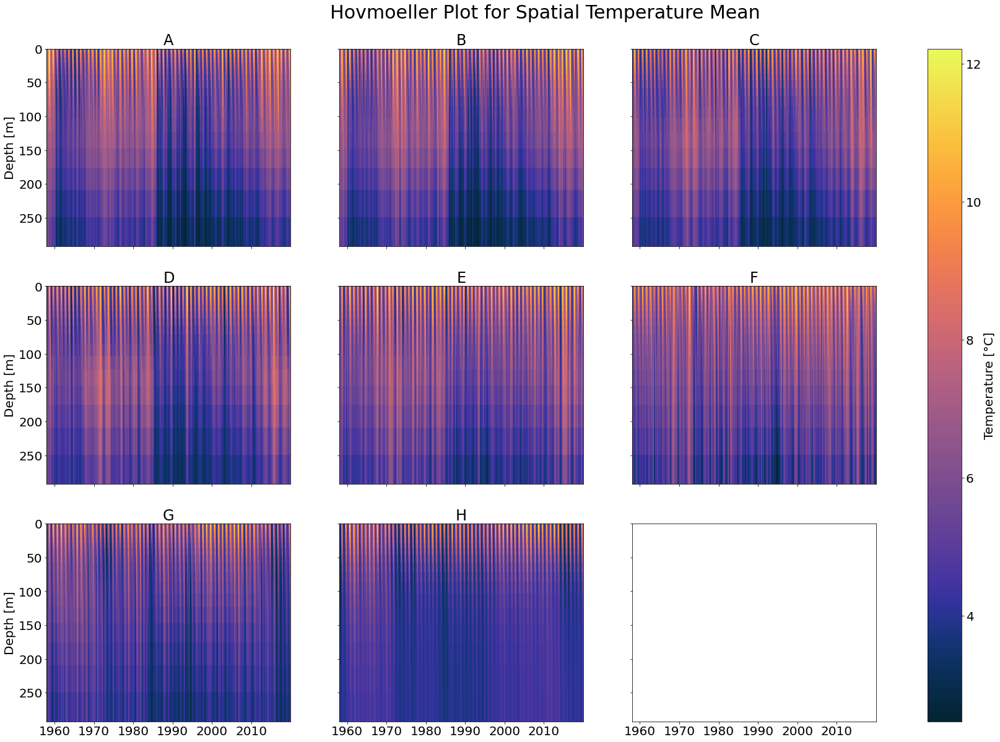

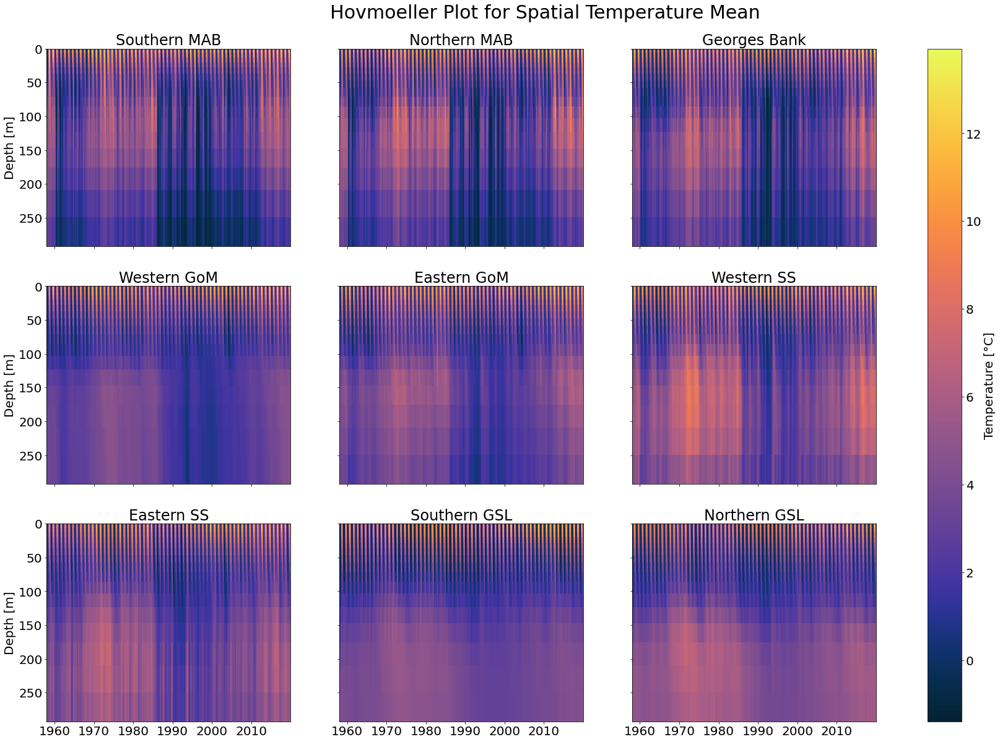

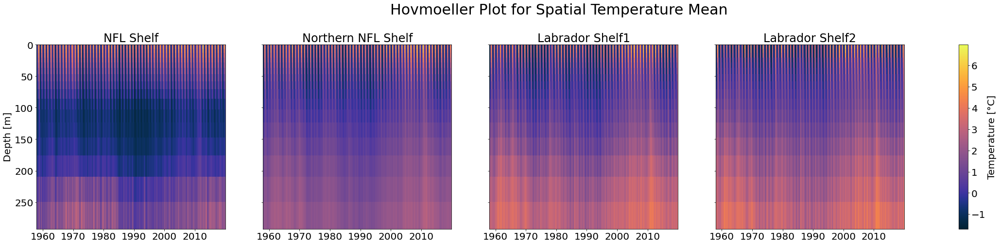

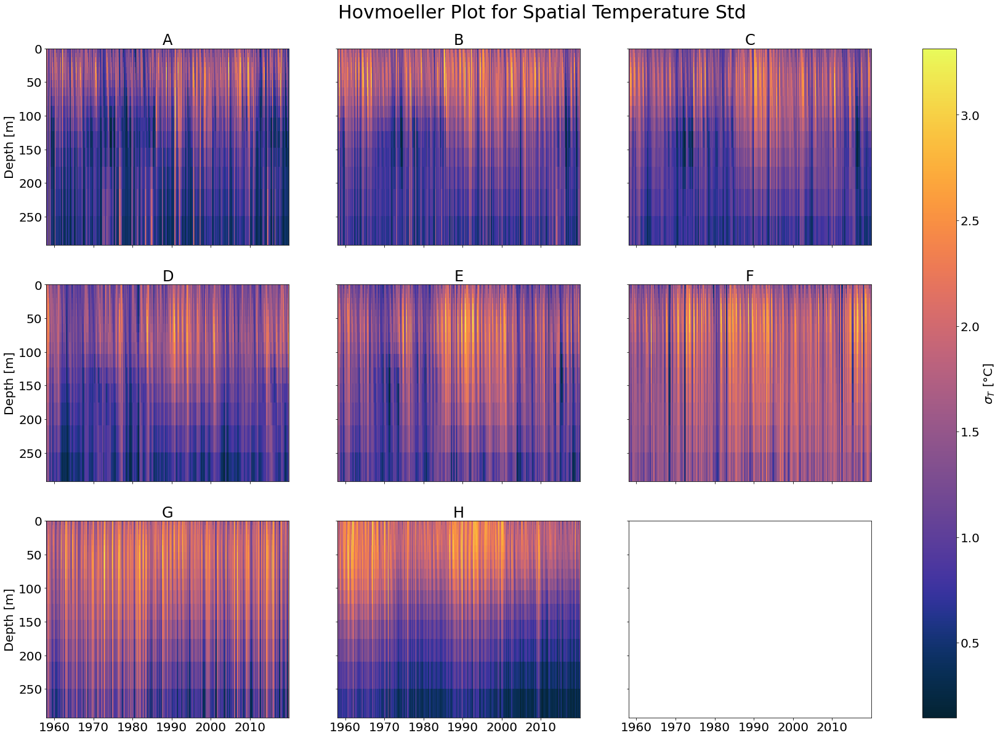

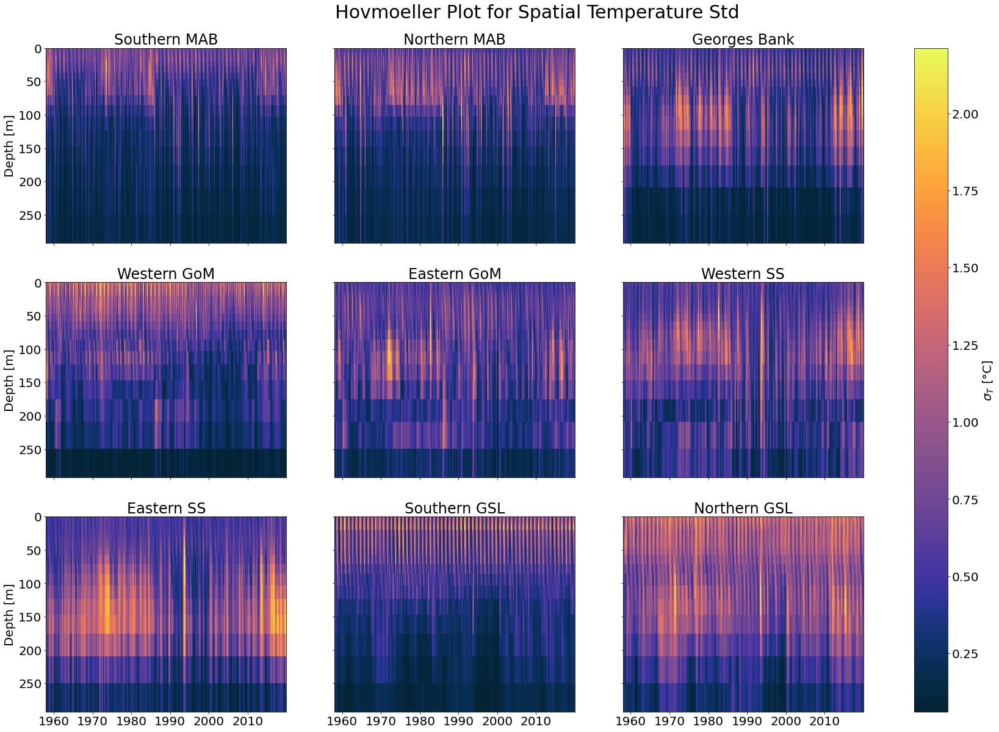

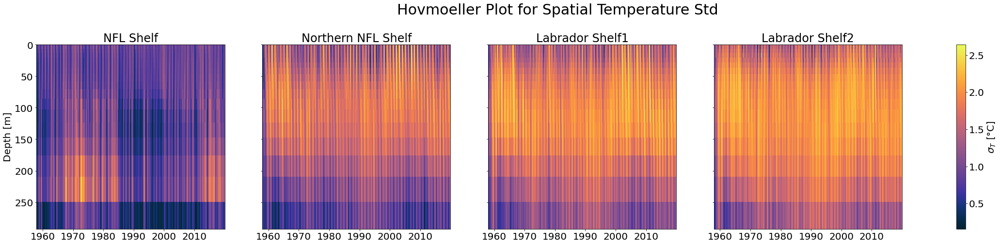

In [7]:
#Plot Hovmoeller diagrams 
plt.rcParams['font.size'] = 20.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean2, axs_mean2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean3, axs_mean3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

#Figures Std
fig_std1, axs_std1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_std2, axs_std2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_std3, axs_std3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

#Set titles
fig_mean1.suptitle('Hovmoeller Plot for Spatial Temperature Mean ', fontsize = 30, y = 0.93)
fig_mean2.suptitle('Hovmoeller Plot for Spatial Temperature Mean ', fontsize = 30, y = 0.93)
fig_mean3.suptitle('Hovmoeller Plot for Spatial Temperature Mean ', fontsize = 30, y = 1.05)

fig_std1.suptitle('Hovmoeller Plot for Spatial Temperature Std ', fontsize = 30, y = 0.93)
fig_std2.suptitle('Hovmoeller Plot for Spatial Temperature Std ', fontsize = 30, y = 0.93)
fig_std3.suptitle('Hovmoeller Plot for Spatial Temperature Std ', fontsize = 30, y = 1.05)

#cmap - does not work yet
cmap = 'cmo.thermal'
N = 10

#Mean plots
i = 0
for ax in axs_mean1.flat:
    
    if i != 8:
    
        #Labels and Title
        colorplot = ax.pcolormesh(temp_mean[masks[i]].time_counter.values, temp_mean[masks[i]].deptht,
                      temp_mean[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        
axs_mean1[0][0].invert_yaxis()    

for ax in axs_mean1[:,0]:
    ax.set_ylabel('Depth [m]')


fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Temperature [°C]', location = 'right')
    
for ax in axs_mean2.flat:
    
    #Labels and Title
    colorplot = ax.pcolormesh(temp_mean[masks[i]].time_counter.values, temp_mean[masks[i]].deptht,
                  temp_mean[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
        
    i += 1
    
axs_mean2[0][0].invert_yaxis()
    
for ax in axs_mean2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_mean2.colorbar(colorplot, ax = axs_mean2, label = 'Temperature [°C]', location = 'right')

for ax in axs_mean3.flat:
    
    #Labels and Title
    
    colorplot = ax.pcolormesh(temp_mean[masks[i]].time_counter.values, temp_mean[masks[i]].deptht,
                  temp_mean[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_mean3[0].invert_yaxis()
    
axs_mean3[0].set_ylabel('Depth [m]')
    
fig_mean3.colorbar(colorplot, ax = axs_mean3, label = 'Temperature [°C]', location = 'right')    
    
#Std plots
i = 0
for ax in axs_std1.flat:
    
    if i != 8:
    
        #Labels and Title
        colorplot = ax.pcolormesh(temp_std[masks[i]].time_counter.values, temp_std[masks[i]].deptht,
                      temp_std[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 10)

        ax.set_title(masks[i])
        
        i += 1
    
axs_std1[0][0].invert_yaxis()
    
for ax in axs_std1[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_std1.colorbar(colorplot, ax = axs_std1, label = '$\u03C3_T$ [°C]', location = 'right')        

for ax in axs_std2.flat:
    
    #Labels and Title
    colorplot = ax.pcolormesh(temp_std[masks[i]].time_counter.values, temp_std[masks[i]].deptht,
                  temp_std[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 10)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_std2[0][0].invert_yaxis()
    
for ax in axs_std2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_std2.colorbar(colorplot, ax = axs_std2, label = '$\u03C3_T$ [°C]', location = 'right')        

for ax in axs_std3.flat:
    
    colorplot = ax.pcolormesh(temp_std[masks[i]].time_counter.values, temp_std[masks[i]].deptht,
                  temp_std[masks[i]]['votemper'].T, cmap = cmap)#, vmin = 0, vmax = 10)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_std3[0].invert_yaxis()
    
axs_std3[0].set_ylabel('Depth [m]')

fig_std3.colorbar(colorplot, ax = axs_std3, label = '$\u03C3_T$ [°C]', location = 'right')        
    
    
#Save Figures
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots1_mean_{}.png'.format(depth))
fig_mean2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots2_mean_{}.png'.format(depth))
fig_mean3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots3_mean_{}.png'.format(depth))
fig_std1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots1_std_{}.png'.format(depth))
fig_std2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots2_std_{}.png'.format(depth))
fig_std3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots3_std_{}.png'.format(depth))


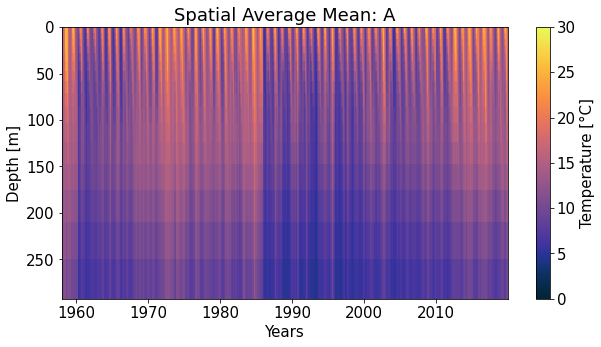

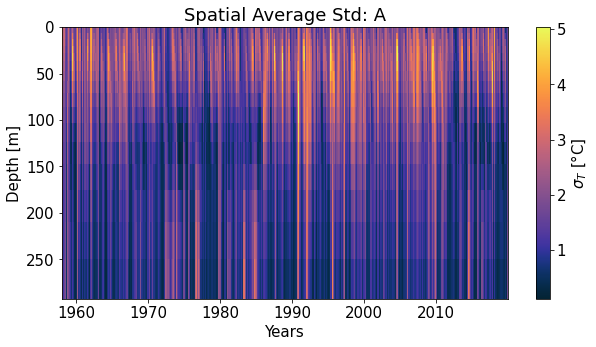

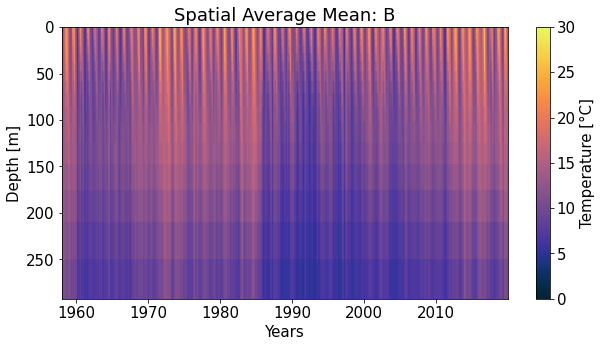

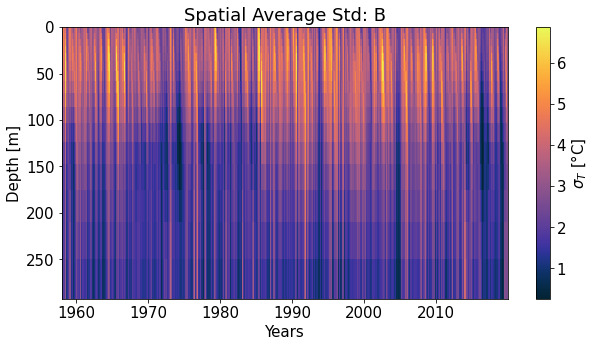

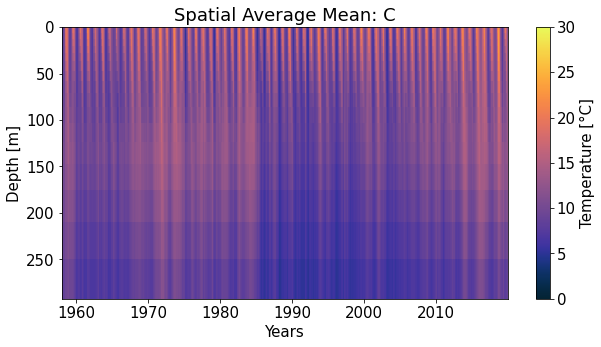

...

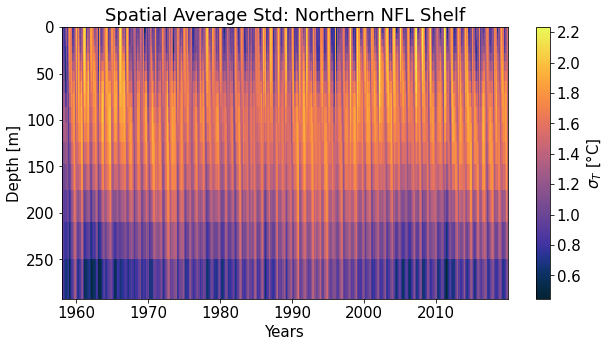

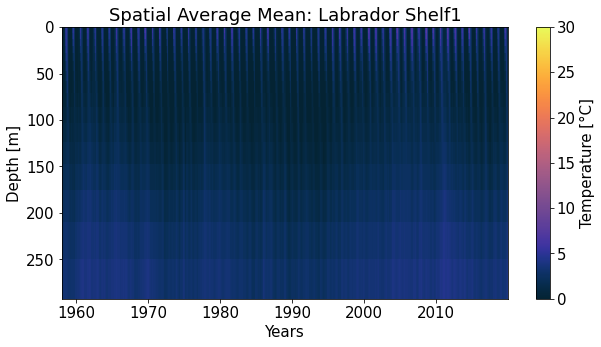

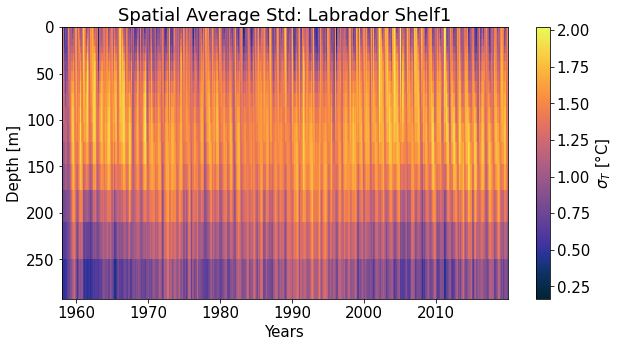

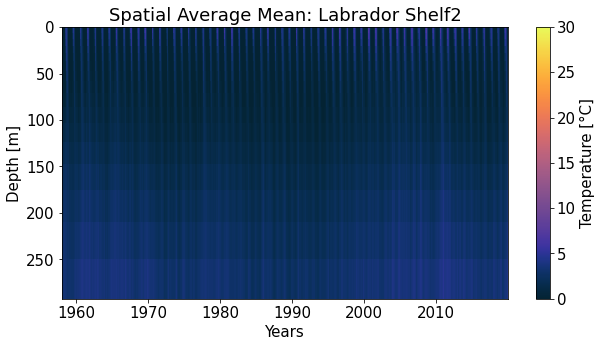

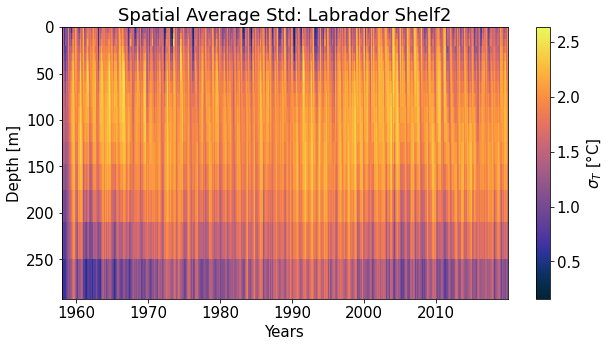

In [8]:
#Plots for each masks
plt.rcParams['font.size'] = 15.0

for i in range(len(masks)):
    
    #Mean
    #Labels and Title
    fig1, ax1 = plt.subplots(figsize = (10,5))
    ax1.set_xlabel('Years')
    ax1.set_ylabel('Depth [m]')
    ax1.set_title('Spatial Average Mean: ' + masks[i])

    #Actual Plot
    colorplot = ax1.pcolormesh(temp_mean[masks[i]].time_counter.values, temp_mean[masks[i]].deptht,
                  temp_mean[masks[i]]['votemper'].T, cmap = 'cmo.thermal', vmin = 0, vmax = 30)

    #Invert y-axis and add colorbar
    ax1.invert_yaxis()
    fig1.colorbar(colorplot, label = 'Temperature [°C]', cmap = 'cmo.thermal')
    plt.show()
    #Save figure 
    fig1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/mean_' + masks[i] + '_{}.png'.format(depth))
    
    #Std
    #Labels and Title
    fig2, ax2 = plt.subplots(figsize = (10,5))
    ax2.set_xlabel('Years')
    ax2.set_ylabel('Depth [m]')
    ax2.set_title('Spatial Average Std: ' + masks[i])

    #Actual Plot
    colorplot = ax2.pcolormesh(temp_std[masks[i]].time_counter.values, temp_std[masks[i]].deptht,
                  temp_std[masks[i]]['votemper'].T, cmap = 'cmo.thermal')

    #Invert y-axis and add colorbar
    ax2.invert_yaxis()
    fig2.colorbar(colorplot, label = '$\u03C3_T$ [°C]', cmap = 'cmo.thermal')
    plt.show()
    #Save figure 
    fig2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/std_' + masks[i] + '_{}.png'.format(depth))  

## Salinity

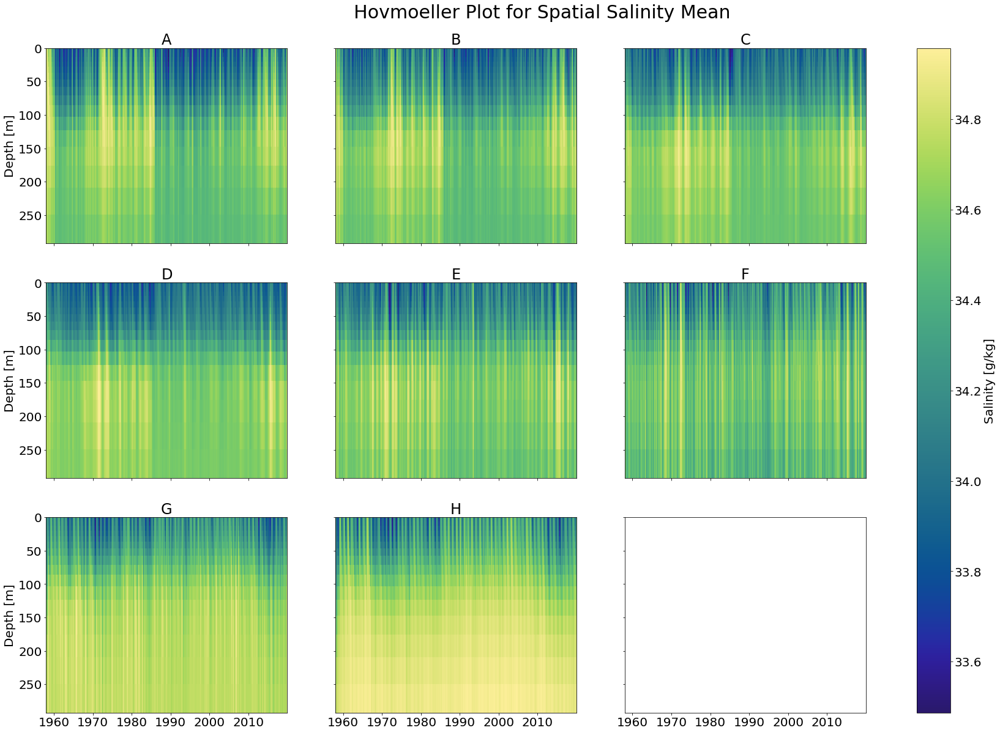

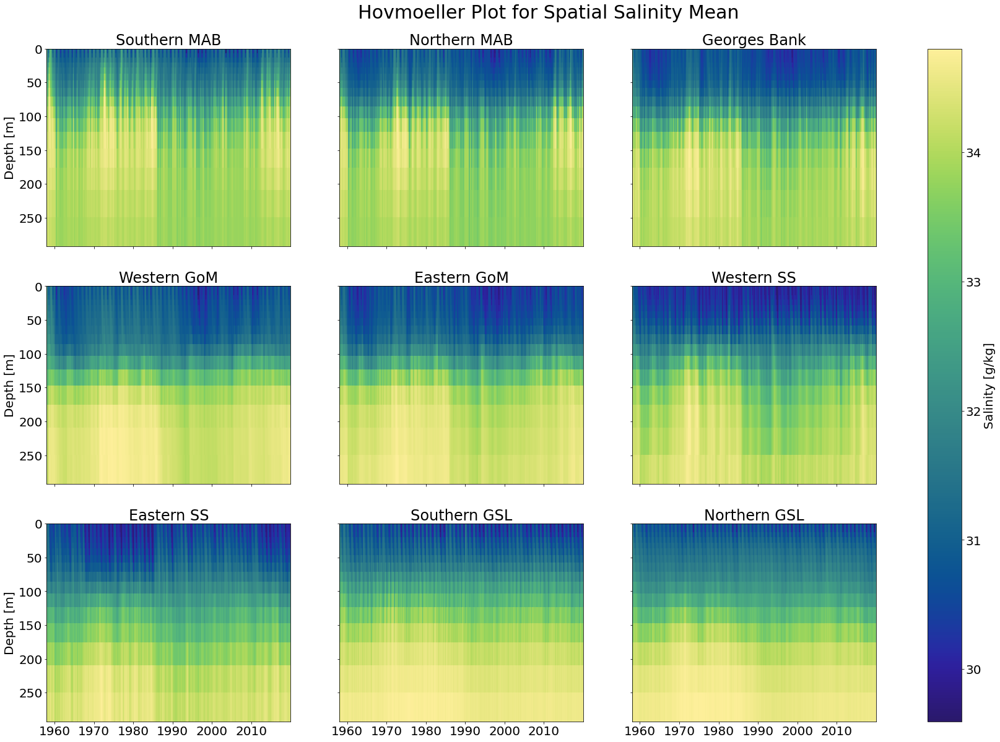

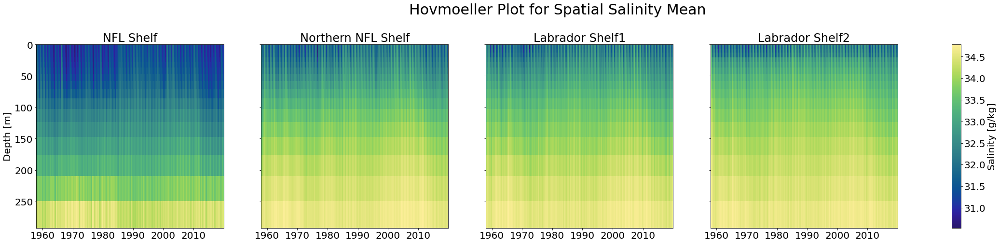

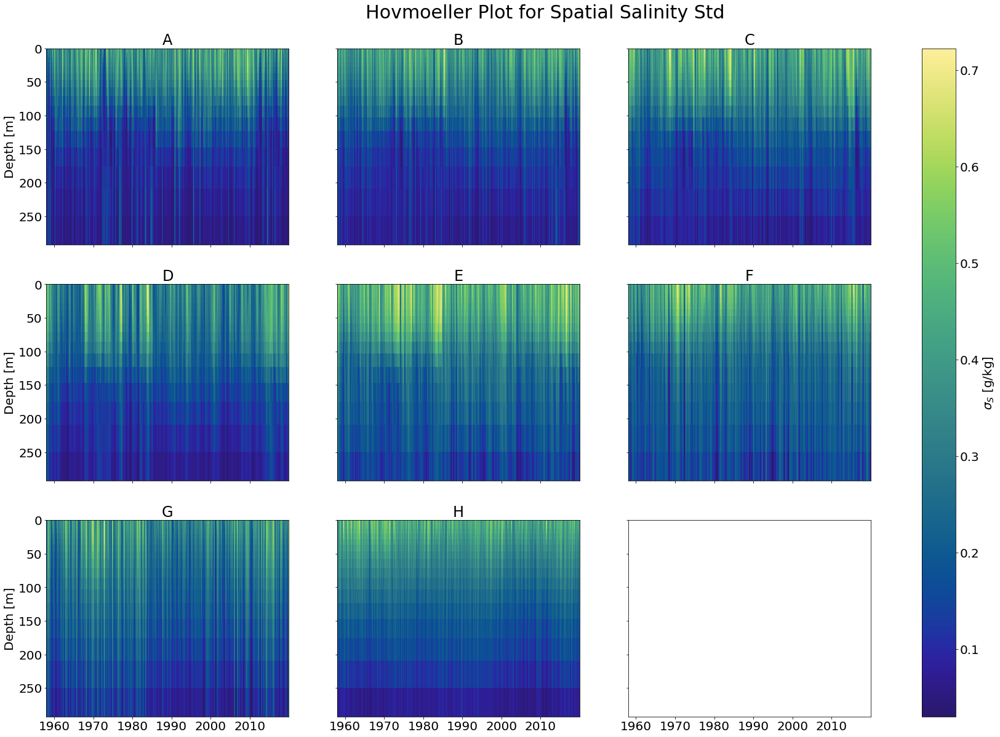

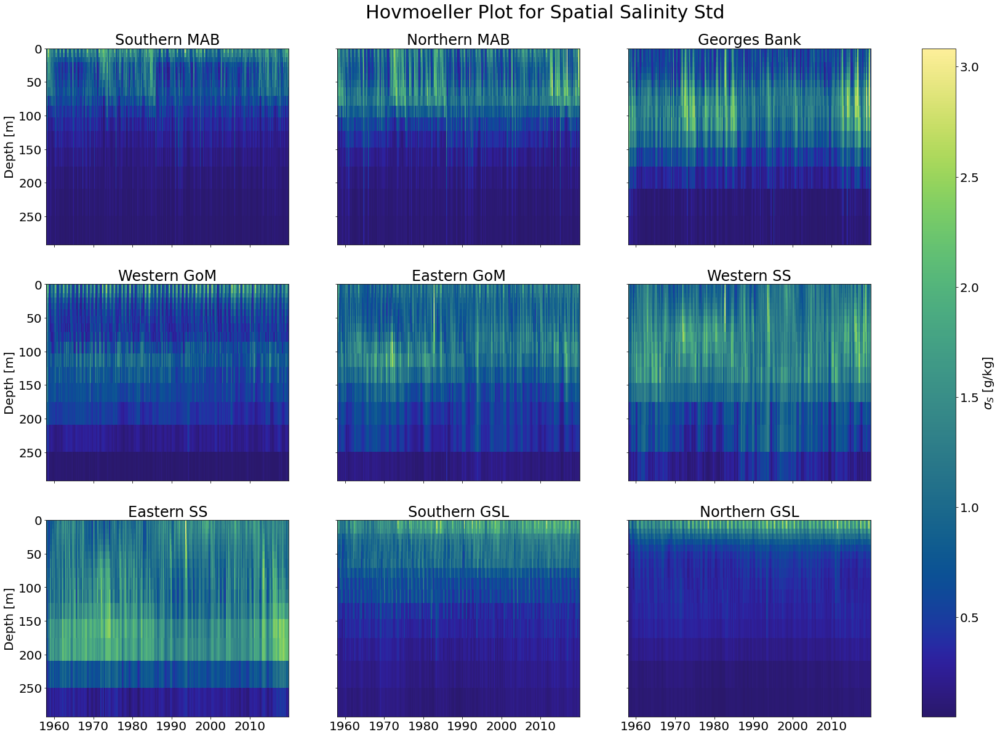

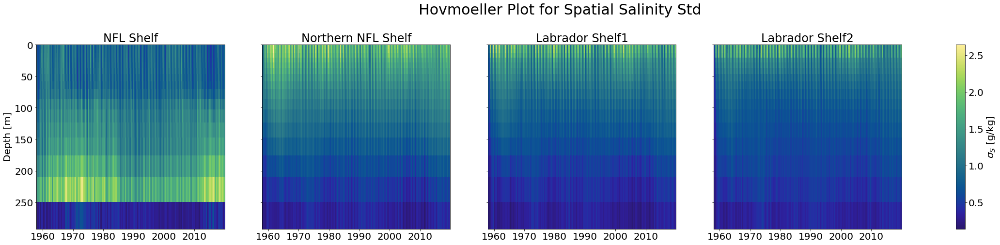

In [9]:
#Plot now Hovmoeller diagrams
plt.rcParams['font.size'] = 20.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean2, axs_mean2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean3, axs_mean3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

#Figures Std
fig_std1, axs_std1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_std2, axs_std2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_std3, axs_std3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

#Set titles
fig_mean1.suptitle('Hovmoeller Plot for Spatial Salinity Mean', fontsize = 30, y = 0.93)
fig_mean2.suptitle('Hovmoeller Plot for Spatial Salinity Mean', fontsize = 30, y = 0.93)
fig_mean3.suptitle('Hovmoeller Plot for Spatial Salinity Mean', fontsize = 30, y = 1.05)

fig_std1.suptitle('Hovmoeller Plot for Spatial Salinity Std', fontsize = 30, y = 0.93)
fig_std2.suptitle('Hovmoeller Plot for Spatial Salinity Std', fontsize = 30, y = 0.93)
fig_std3.suptitle('Hovmoeller Plot for Spatial Salinity Std', fontsize = 30, y = 1.05)

#cmap - does not work yet
cmap = 'cmo.haline'
N = 10

#Mean plots
i = 0
for ax in axs_mean1.flat:
    if i != 8:
    
        #Labels and Title
        colorplot = ax.pcolormesh(sal_mean[masks[i]].time_counter.values, sal_mean[masks[i]].deptht,
                      sal_mean[masks[i]]['vosaline'].T, cmap = cmap)#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        
axs_mean1[0][0].invert_yaxis()    

for ax in axs_mean1[:,0]:
    ax.set_ylabel('Depth [m]')


fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Salinity [g/kg]', location = 'right')
    
for ax in axs_mean2.flat:
    
    #Labels and Title
    colorplot = ax.pcolormesh(sal_mean[masks[i]].time_counter.values, sal_mean[masks[i]].deptht,
                  sal_mean[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_mean2[0][0].invert_yaxis()
    
for ax in axs_mean2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_mean2.colorbar(colorplot, ax = axs_mean2, label = 'Salinity [g/kg]', location = 'right')

for ax in axs_mean3.flat:
    
    #Labels and Title
    
    colorplot = ax.pcolormesh(sal_mean[masks[i]].time_counter.values, sal_mean[masks[i]].deptht,
                  sal_mean[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    ax.invert_yaxis()
    
    i += 1
    
axs_mean3[0].invert_yaxis()
    
axs_mean3[0].set_ylabel('Depth [m]')
    
fig_mean3.colorbar(colorplot, ax = axs_mean3, label = 'Salinity [g/kg]', location = 'right')    
    
#Std plots
i = 0
for ax in axs_std1.flat:
    
    if i != 8:
    
        #Labels and Title
        colorplot = ax.pcolormesh(sal_std[masks[i]].time_counter.values, sal_std[masks[i]].deptht,
                      sal_std[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 10)

        ax.set_title(masks[i])
        
        i += 1
    
axs_std1[0][0].invert_yaxis()
    
for ax in axs_std1[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_std1.colorbar(colorplot, ax = axs_std1, label = '$\u03C3_S$ [g/kg]', location = 'right')        

for ax in axs_std2.flat:
    
    #Labels and Title
    colorplot = ax.pcolormesh(sal_std[masks[i]].time_counter.values, sal_std[masks[i]].deptht,
                  sal_std[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 10)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_std2[0][0].invert_yaxis()
    
for ax in axs_std2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_std2.colorbar(colorplot, ax = axs_std2, label = '$\u03C3_S$ [g/kg]', location = 'right')        

for ax in axs_std3.flat:
    
    colorplot = ax.pcolormesh(sal_std[masks[i]].time_counter.values, sal_std[masks[i]].deptht,
                  sal_std[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 10)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_std3[0].invert_yaxis()
    
axs_std3[0].set_ylabel('Depth [m]')

fig_std3.colorbar(colorplot, ax = axs_std3, label = '$\u03C3_S$ [g/kg]', location = 'right')        
    
    
#Save Figures
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots1_mean_{}.png'.format(depth))
fig_mean2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots2_mean_{}.png'.format(depth))
fig_mean3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots3_mean_{}.png'.format(depth))
fig_std1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots1_std_{}.png'.format(depth))
fig_std2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots2_std_{}.png'.format(depth))
fig_std3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots3_std_{}.png'.format(depth))

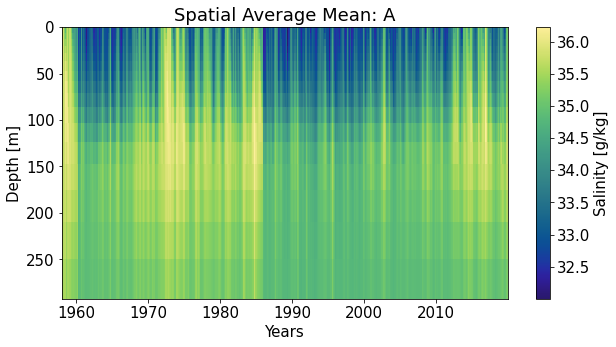

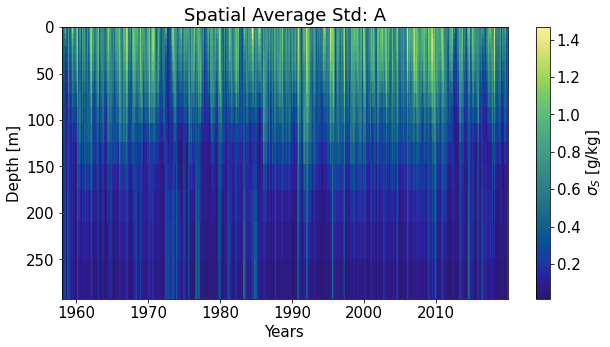

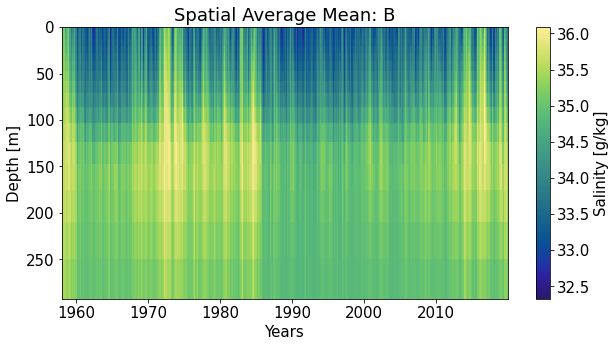

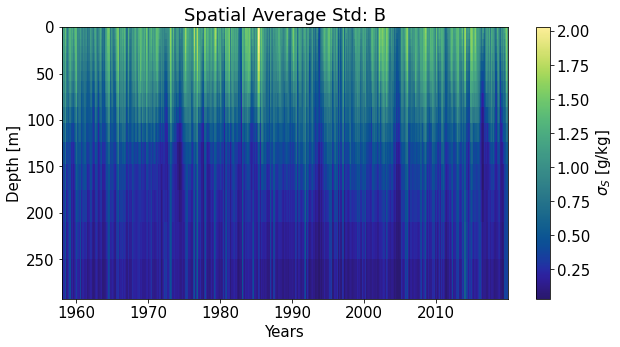

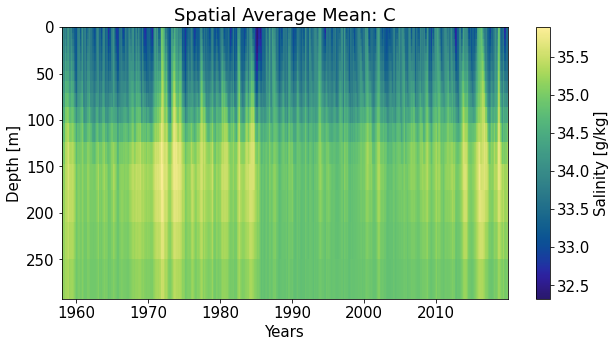

...

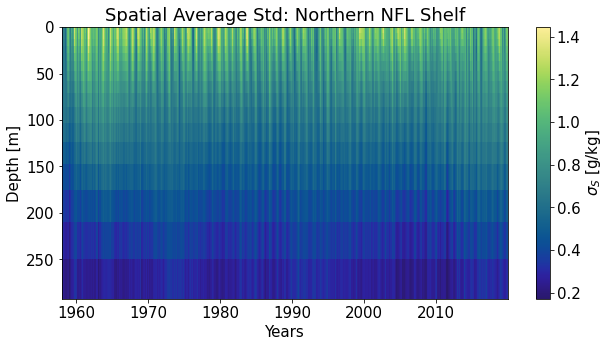

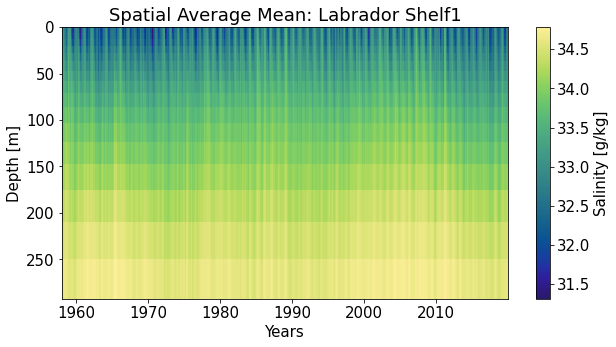

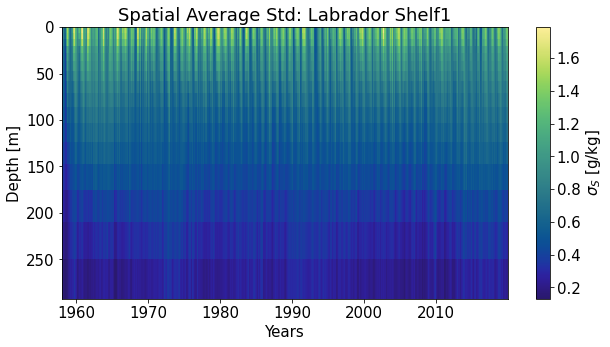

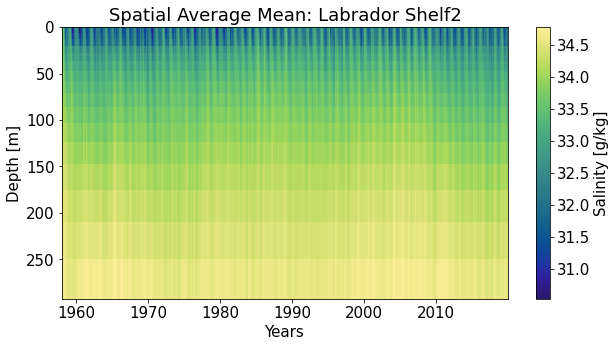

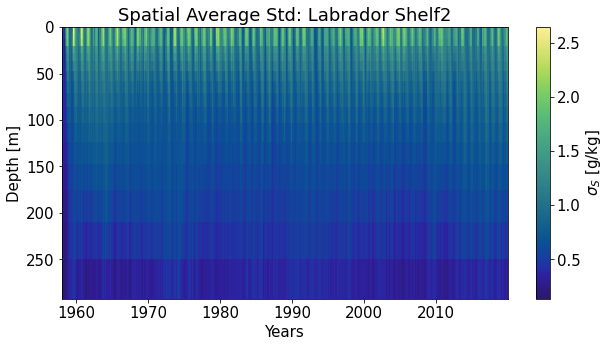

In [10]:
plt.rcParams['font.size'] = 15.0

#Plots one by one
for i in range(len(masks)):
    
    #Mean
    #Labels and Title
    fig1, ax1 = plt.subplots(figsize = (10,5))
    ax1.set_xlabel('Years')
    ax1.set_ylabel('Depth [m]')
    ax1.set_title('Spatial Average Mean: ' + masks[i])

    #Actual Plot
    colorplot = ax1.pcolormesh(sal_mean[masks[i]].time_counter.values, sal_mean[masks[i]].deptht,
                  sal_mean[masks[i]]['vosaline'].T, cmap = 'cmo.haline')#, vmin = 0, vmax = 30)

    #Invert y-axis and add colorbarf
    ax1.invert_yaxis()
    fig1.colorbar(colorplot, label = 'Salinity [g/kg]', cmap = 'cmo.haline')
    plt.show()
    #Save figure 
    fig1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/mean_' + masks[i] + '_{}.png'.format(depth))
    
    #Std
    #Labels and Title
    fig2, ax2 = plt.subplots(figsize = (10,5))
    ax2.set_xlabel('Years')
    ax2.set_ylabel('Depth [m]')
    ax2.set_title('Spatial Average Std: ' + masks[i])

    #Actual Plot
    colorplot = ax2.pcolormesh(sal_std[masks[i]].time_counter.values, sal_std[masks[i]].deptht,
                  sal_std[masks[i]]['vosaline'].T, cmap = 'cmo.haline')

    #Invert y-axis and add colorbar
    ax2.invert_yaxis()
    fig2.colorbar(colorplot, label = '$\u03C3_S$ [g/kg]', cmap = 'cmo.haline')
    plt.show()
    #Save figure 
    fig2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/mean_' + masks[i] + '_{}.png'.format(depth))  

# Seasonal Cycle


In [11]:
#Group data to obtain mean seasonal cycle
temp_mon = {}
sal_mon = {}

for i in range(len(masks)):
    
    #Choose data from 1990-2019, group per month and calculate mean
    temp_mon[masks[i]] = temp_mean[masks[i]].groupby('time_counter.month').mean(dim = 'time_counter')
    sal_mon[masks[i]] = sal_mean[masks[i]].groupby('time_counter.month').mean(dim = 'time_counter')

## Temperature

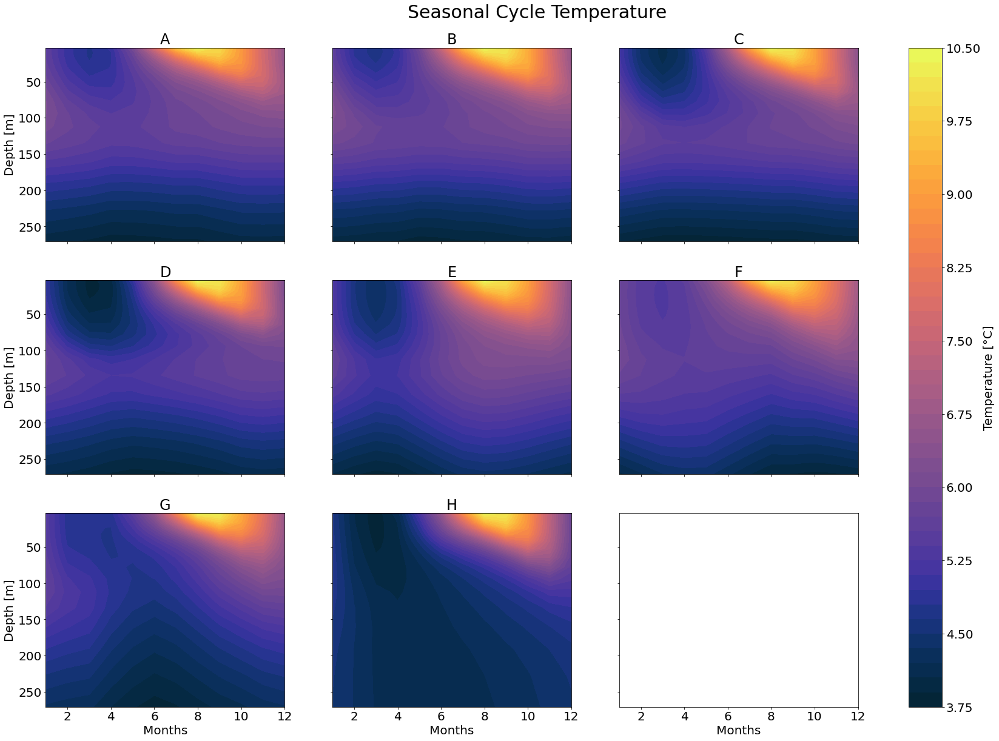

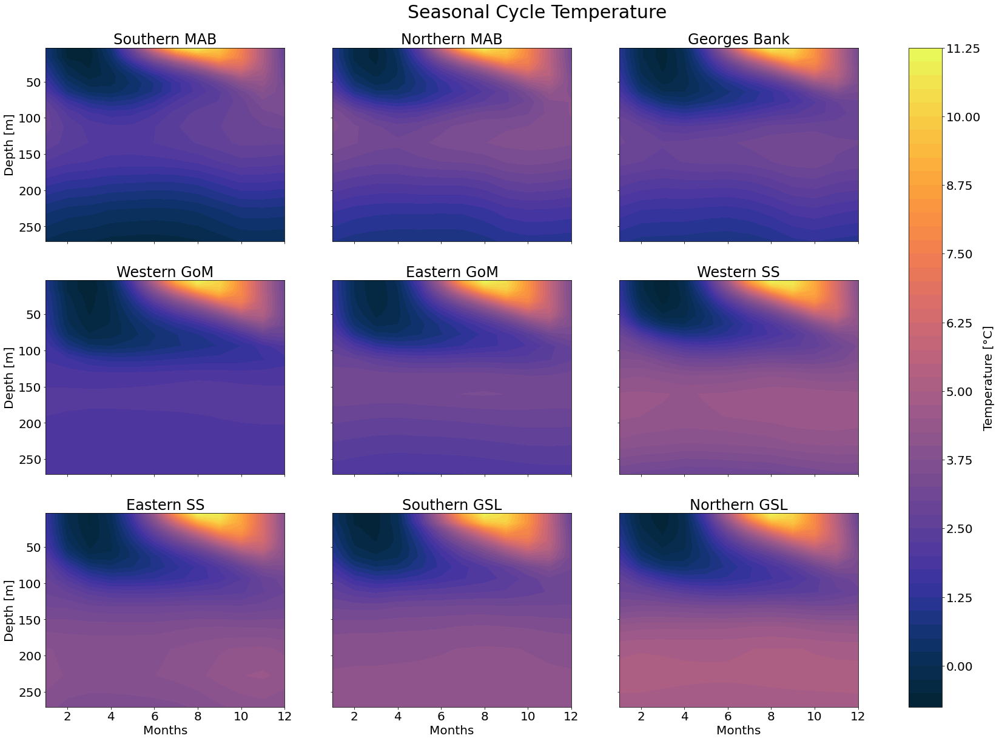

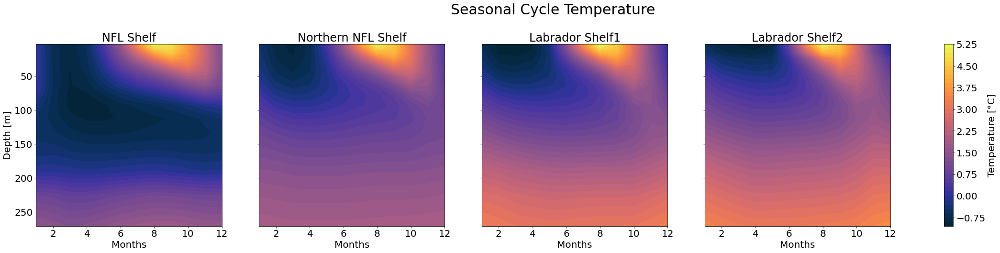

In [12]:
#Plot Hovmoeller diagrams of seasonal cycle
plt.rcParams['font.size'] = 20.0

#Create figures for all masks in subplots
fig_temp1, axs_temp1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_temp2, axs_temp2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_temp3, axs_temp3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

#Set titles
fig_temp1.suptitle('Seasonal Cycle Temperature', fontsize = 30, y = 0.93)
fig_temp2.suptitle('Seasonal Cycle Temperature', fontsize = 30, y = 0.93)
fig_temp3.suptitle('Seasonal Cycle Temperature', fontsize = 30, y = 1.05)

#cmap
cmap = 'cmo.thermal'
levels = 50

#Temp plots
i = 0
for ax in axs_temp1.flat:
    
    if i != 8:
    
        #Labels and Title
        colorplot = ax.contourf(temp_mon[masks[i]].month, temp_mon[masks[i]].deptht, 
                      temp_mon[masks[i]]['votemper'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        
axs_temp1[0][0].invert_yaxis()    

for ax in axs_temp1[:,0]:
    ax.set_ylabel('Depth [m]')

for ax in axs_temp1[2,:]:
    ax.set_xlabel('Months')
    
fig_temp1.colorbar(colorplot, ax = axs_temp1, label = 'Temperature [°C]', location = 'right')
    
for ax in axs_temp2.flat:
    
    #Labels and Title
    colorplot = ax.contourf(temp_mon[masks[i]].month, temp_mon[masks[i]].deptht, 
                  temp_mon[masks[i]]['votemper'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_temp2[0][0].invert_yaxis()
    
for ax in axs_temp2[:,0]:
    ax.set_ylabel('Depth [m]')
    
for ax in axs_temp2[2,:]:
    ax.set_xlabel('Months')
    
fig_temp2.colorbar(colorplot, ax = axs_temp2, label = 'Temperature [°C]', location = 'right')

for ax in axs_temp3.flat:
    
    #Labels and Title
    
    colorplot = ax.contourf(temp_mon[masks[i]].month, temp_mon[masks[i]].deptht, 
                  temp_mon[masks[i]]['votemper'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])

    ax.set_xlabel('Months')
    i += 1

axs_temp3[0].invert_yaxis()
axs_temp3[0].set_ylabel('Depth [m]')

fig_temp3.colorbar(colorplot, ax = axs_temp3, label = 'Temperature [°C]', location = 'right')    
    
#Save Figures
fig_temp1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_seas_cyc1_{}.png'.format(depth))
fig_temp2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_seas_cyc2_{}.png'.format(depth))
fig_temp3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_seas_cyc3_{}.png'.format(depth))


## Salinity

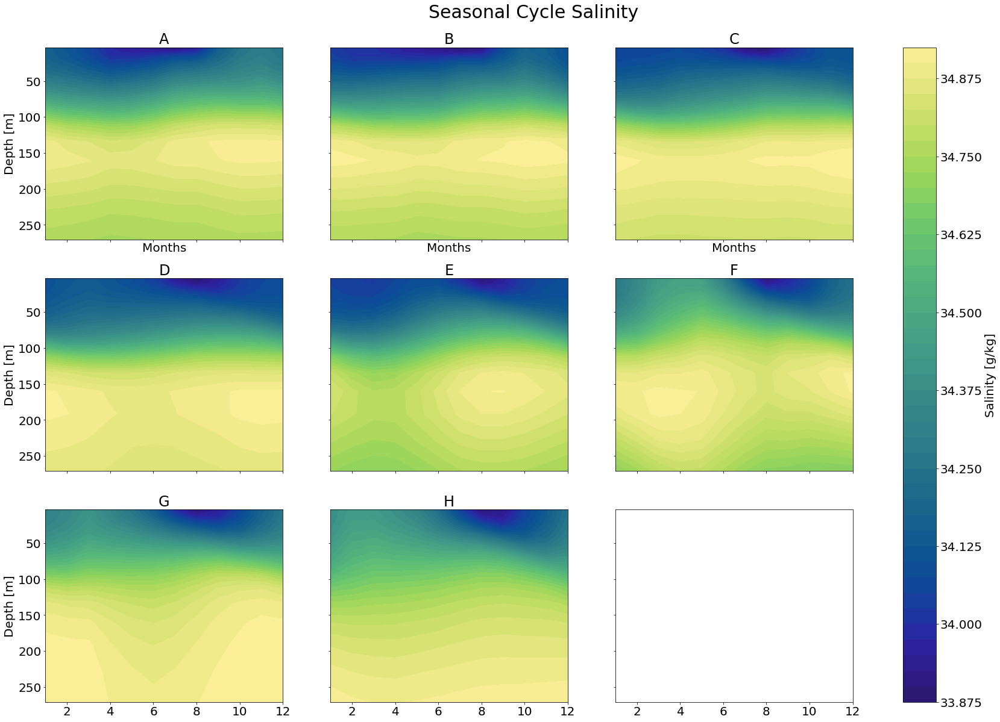

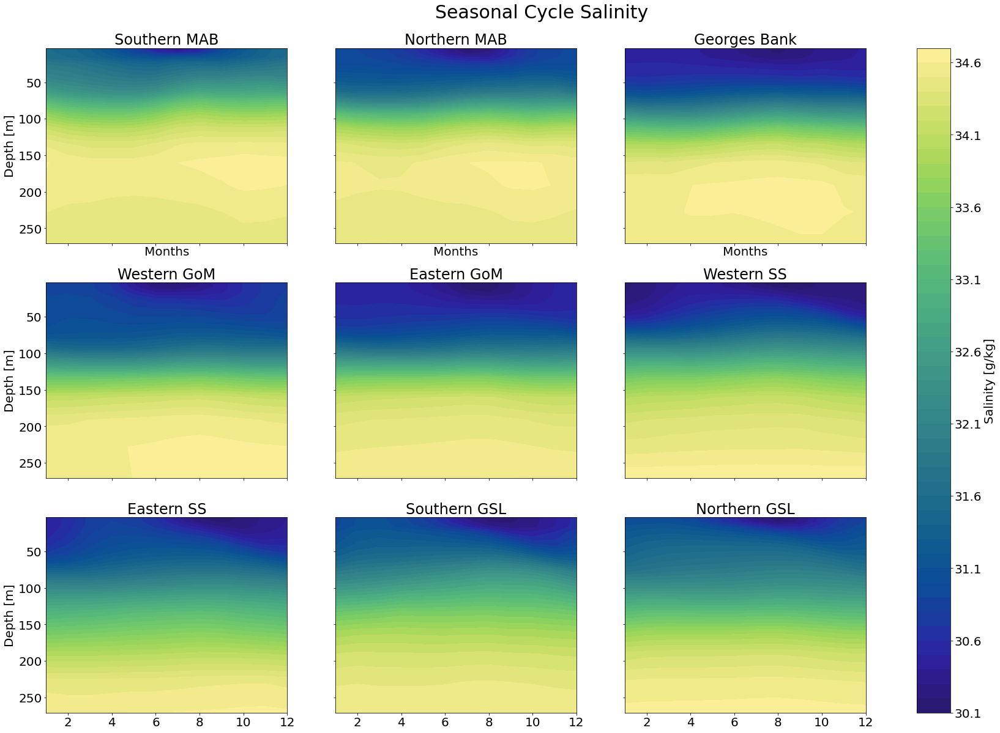

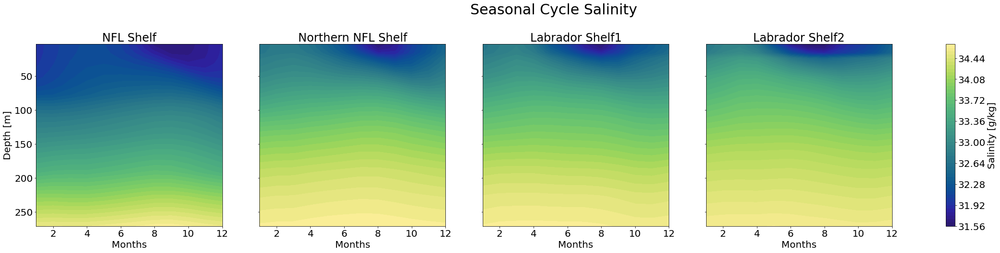

In [13]:
#Plot Hovmoeller diagrams of seasonal cycle
plt.rcParams['font.size'] = 20.0

#Create Figures for all masks
fig_sal1, axs_sal1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_sal2, axs_sal2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_sal3, axs_sal3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

fig_sal1.suptitle('Seasonal Cycle Salinity', fontsize = 30, y = 0.93)
fig_sal2.suptitle('Seasonal Cycle Salinity', fontsize = 30, y = 0.93)
fig_sal3.suptitle('Seasonal Cycle Salinity', fontsize = 30, y = 1.05)

cmap = 'cmo.haline'

#Sal plots
i = 0
for ax in axs_sal1.flat:
    
    if i != 8:
    
        #Labels and Title
        colorplot = ax.contourf(sal_mon[masks[i]].month, sal_mon[masks[i]].deptht, 
                      sal_mon[masks[i]]['vosaline'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        
axs_sal1[0][0].invert_yaxis()    

for ax in axs_sal1[:,0]:
    ax.set_ylabel('Depth [m]')

for ax in axs_sal1[0,:]:
    ax.set_xlabel('Months')

fig_sal1.colorbar(colorplot, ax = axs_sal1, label = 'Salinity [g/kg]', location = 'right')
    
for ax in axs_sal2.flat:
    
    #Labels and Title
    colorplot = ax.contourf(sal_mon[masks[i]].month, sal_mon[masks[i]].deptht, 
                  sal_mon[masks[i]]['vosaline'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    
    i += 1
    
axs_sal2[0][0].invert_yaxis()    
    
for ax in axs_sal2[:,0]:
    ax.set_ylabel('Depth [m]')

for ax in axs_sal2[0,:]:
    ax.set_xlabel('Months')
    
fig_sal2.colorbar(colorplot, ax = axs_sal2, label = 'Salinity [g/kg]', location = 'right')

for ax in axs_sal3.flat:
    
    #Labels and Title
    
    colorplot = ax.contourf(sal_mon[masks[i]].month, sal_mon[masks[i]].deptht, 
                  sal_mon[masks[i]]['vosaline'].T, cmap = cmap, levels = levels)#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])
    ax.set_xlabel('Months')
    
    i += 1

axs_sal3[0].invert_yaxis()    
axs_sal3[0].set_ylabel('Depth [m]')

fig_sal3.colorbar(colorplot, ax = axs_sal3, label = 'Salinity [g/kg]', location = 'right')    

fig_sal1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_seas_cyc1_{}.png'.format(depth))
fig_sal2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_seas_cyc2_{}.png'.format(depth))
fig_sal3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_seas_cyc3_{}.png'.format(depth))

# Analysis of anomalies
## Remove seasonal cycle
Used reference time period: 1990-2019

In [14]:
#Define time periods for composites of decadal variability
time_periods = ['1960', '1968', '1986', '2012']

In [15]:
#Deduct seasonal cycle from data
temp_mean_ref = {}
temp_mean_anom = {}

sal_mean_ref = {}
sal_mean_anom = {}

for i in range(len(masks)):
    
    #Choose data from 1990-2019, group per month and calculate mean
    temp_mean_ref[masks[i]] = temp_mean[masks[i]].sel(time_counter = slice('01-01-1990', '31-12-2019')).groupby('time_counter.month').mean(dim = 'time_counter')
    sal_mean_ref[masks[i]] = sal_mean[masks[i]].sel(time_counter = slice('01-01-1990', '31-12-2019')).groupby('time_counter.month').mean(dim = 'time_counter')
    
    #Substract climatological cycle from data
    temp_mean_anom[masks[i]] = temp_mean[masks[i]].groupby('time_counter.month') - temp_mean_ref[masks[i]]
    sal_mean_anom[masks[i]] = sal_mean[masks[i]].groupby('time_counter.month') - sal_mean_ref[masks[i]]

## Hovmoeller-Plots for anomalies
### Temperature

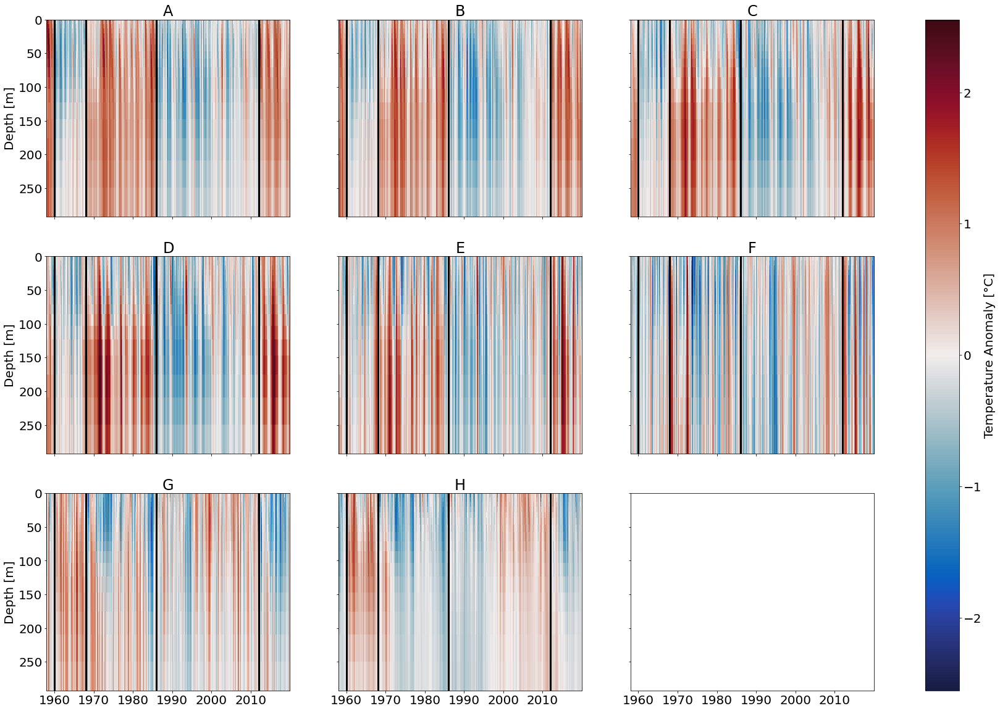

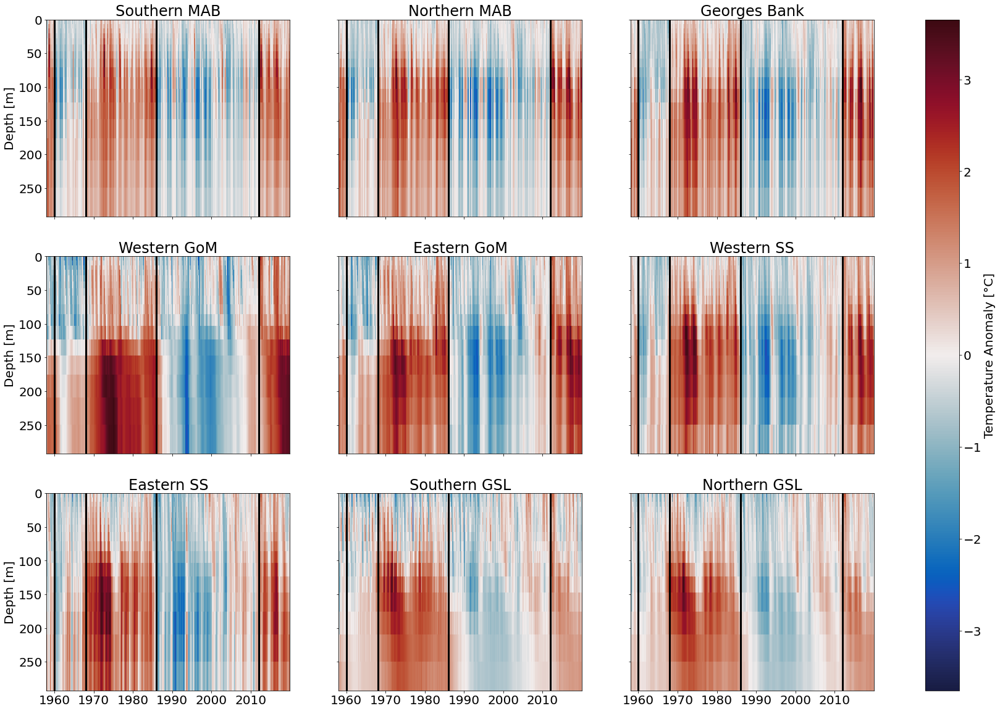

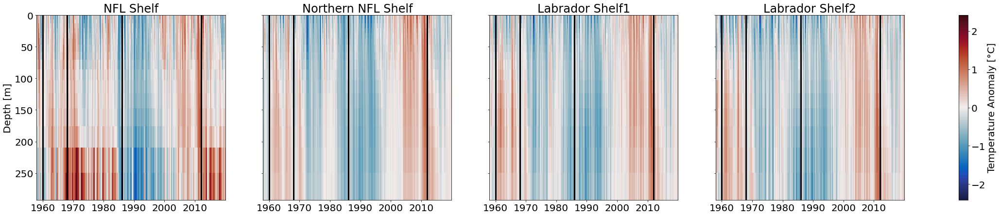

In [16]:
#Plot Hovmoeller diagrams without seasonal cycles (Anomalies)
plt.rcParams['font.size'] = 20.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean2, axs_mean2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean3, axs_mean3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)


#cmap - does not work yet
cmap = 'cmo.balance'
 
#Mean plots
i = 0
for ax in axs_mean1.flat:
    
    if i != 8:
    
        #Labels and Title
         
        colorplot = ax.pcolormesh(temp_mean_anom[masks[i]].time_counter.values, temp_mean_anom[masks[i]].deptht,
                      temp_mean_anom[masks[i]]['votemper'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
        
axs_mean1[0][0].invert_yaxis()    

for ax in axs_mean1[:,0]:
    ax.set_ylabel('Depth [m]')

fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Temperature Anomaly [°C]', location = 'right')
    
for ax in axs_mean2.flat:
    
    #Labels and Title
     
    colorplot = ax.pcolormesh(temp_mean_anom[masks[i]].time_counter.values, temp_mean_anom[masks[i]].deptht,
                  temp_mean_anom[masks[i]]['votemper'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])

    for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
    i += 1
    
axs_mean2[0][0].invert_yaxis()        

for ax in axs_mean2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_mean2.colorbar(colorplot, ax = axs_mean2, label = 'Temperature Anomaly [°C]', location = 'right')

for ax in axs_mean3.flat:
    
    #Labels and Title
     
    colorplot = ax.pcolormesh(temp_mean_anom[masks[i]].time_counter.values, temp_mean_anom[masks[i]].deptht,
                  temp_mean_anom[masks[i]]['votemper'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])

    for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
    i += 1
    
axs_mean3[0].invert_yaxis()    
axs_mean3[0].set_ylabel('Depth [m]')
    
fig_mean3.colorbar(colorplot, ax = axs_mean3, label = 'Temperature Anomaly [°C]', location = 'right')    
    
    
#Save Figures
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_anom1_{}.png'.format(depth))
fig_mean2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_anom2_{}.png'.format(depth))
fig_mean3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_anom3_{}.png'.format(depth))

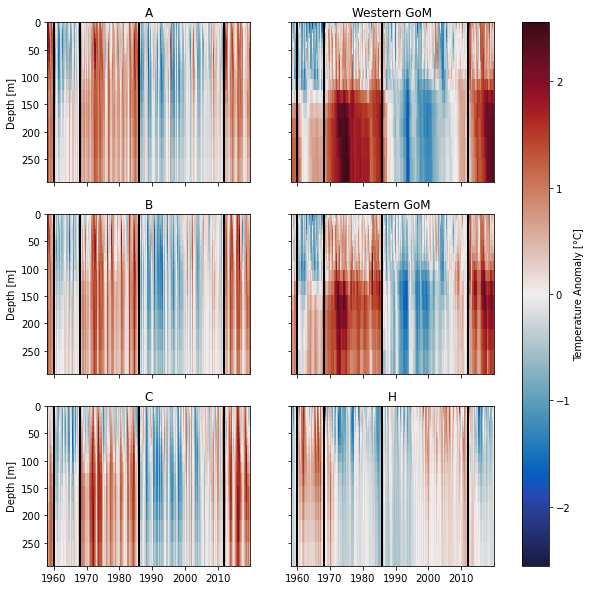

In [17]:
#Plot Hovmoeller diagrams without seasonal cycles (Anomalies) for some chosen masks
plt.rcParams['font.size'] = 10.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 2, figsize = (10,10), sharex = True, sharey = True)

#cmap - does not work yet
cmap = 'cmo.balance'

#Choose desired masks
masks_reorder = ['A', 'Western GoM', 'B', 'Eastern GoM', 'C', 'H']

#Mean plots
i = 0
axs_mean1[0][0].invert_yaxis()    
for ax in axs_mean1.flat:
    
    if i != 8:
    
        #Labels and Title
         
        colorplot = ax.pcolormesh(temp_mean_anom[masks_reorder[i]].time_counter.values, temp_mean_anom[masks_reorder[i]].deptht,
                      temp_mean_anom[masks_reorder[i]]['votemper'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)

        ax.set_title(masks_reorder[i])
        i += 1
        for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 2)

for ax in axs_mean1[:,0]: 
    ax.set_ylabel('Depth [m]')

fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Temperature Anomaly [°C]', location = 'right')
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/subplots_ABC45H_{}.png'.format(depth))    




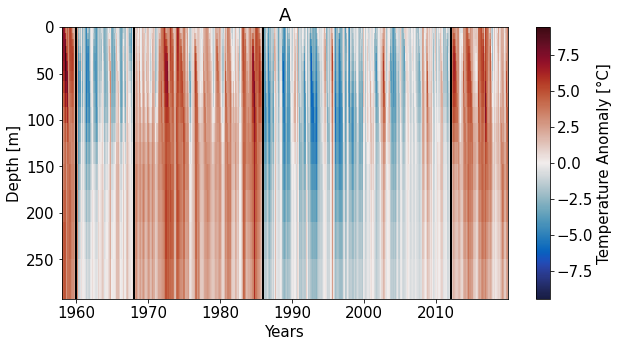

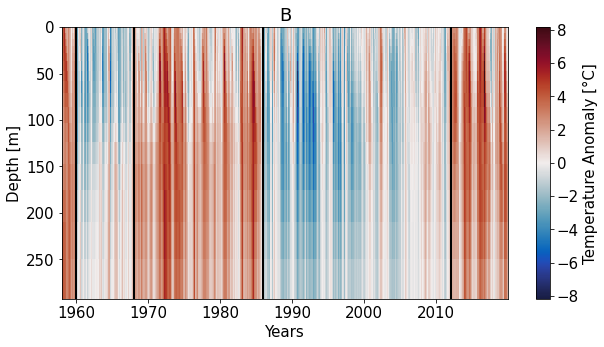

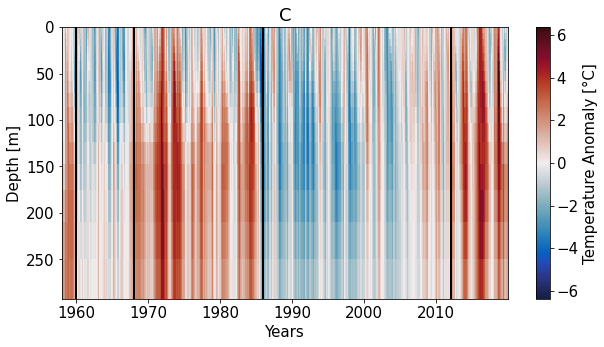

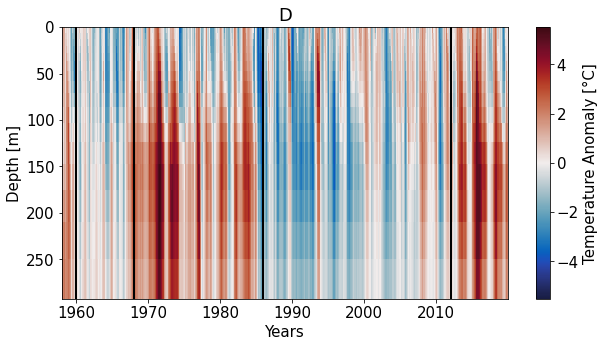

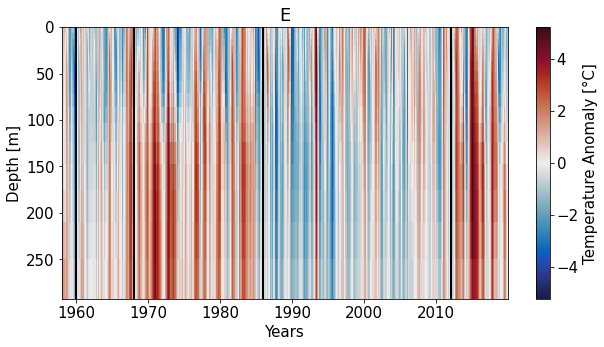

...

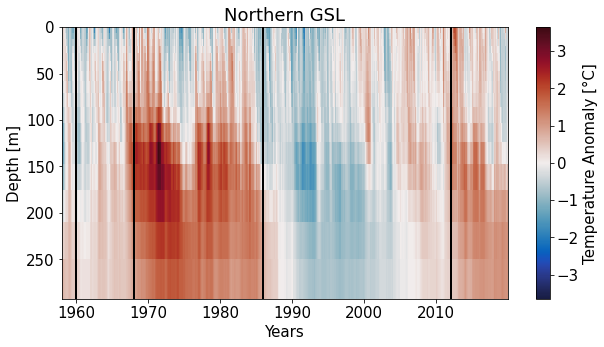

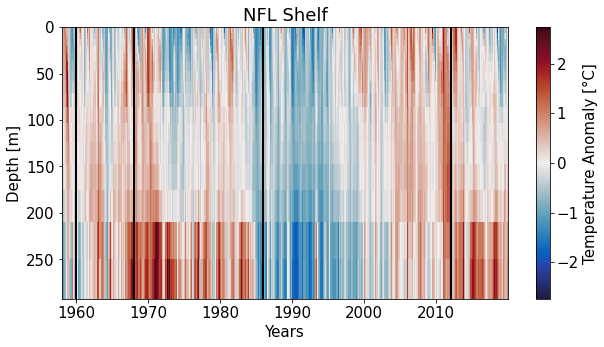

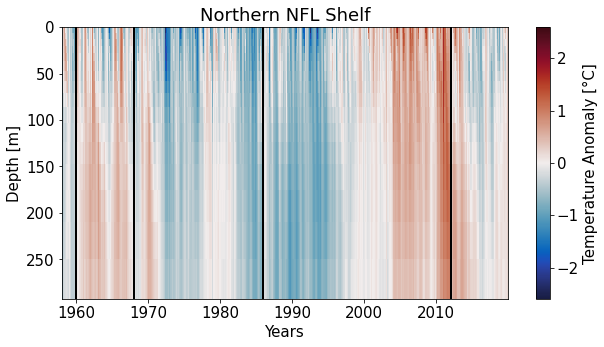

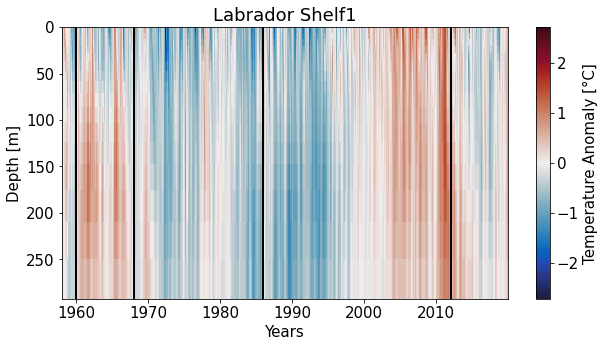

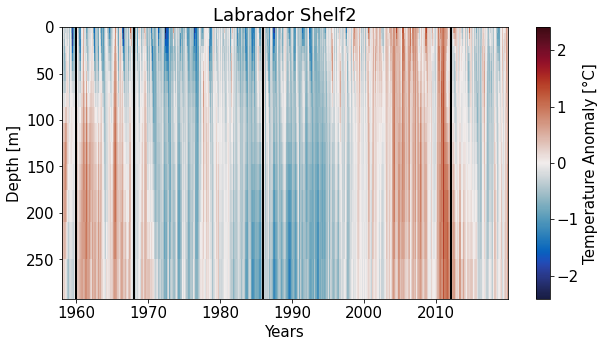

In [18]:
#Plots one by one without seasonal cycle
plt.rcParams['font.size'] = 15.0
cmap = 'cmo.balance'

for i in range(len(masks)):
    
    #Mean
    #Labels and Title
    fig1, ax1 = plt.subplots(figsize = (10,5))
    ax1.set_xlabel('Years')
    ax1.set_ylabel('Depth [m]')
    ax1.set_title(masks[i])

    #Actual Plot
    colorplot = ax1.pcolormesh(temp_mean_anom[masks[i]].time_counter.values, temp_mean_anom[masks[i]].deptht,
                  temp_mean_anom[masks[i]]['votemper'].T, cmap = cmap, norm = colors.CenteredNorm())

    #Invert y-axis and add colorbar
    ax1.invert_yaxis()
    fig1.colorbar(colorplot, label = 'Temperature Anomaly [°C]', cmap = cmap)
    
    #Add vlines for time period
    for j in range(len(time_periods)):
        ax1.axvline(x = time_periods[j], color = 'black', linewidth = 2)
    
    plt.show()
    #Save figure 
    fig1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Temp/anom_' + masks[i] + '_{}.png'.format(depth))
    

### Salinity

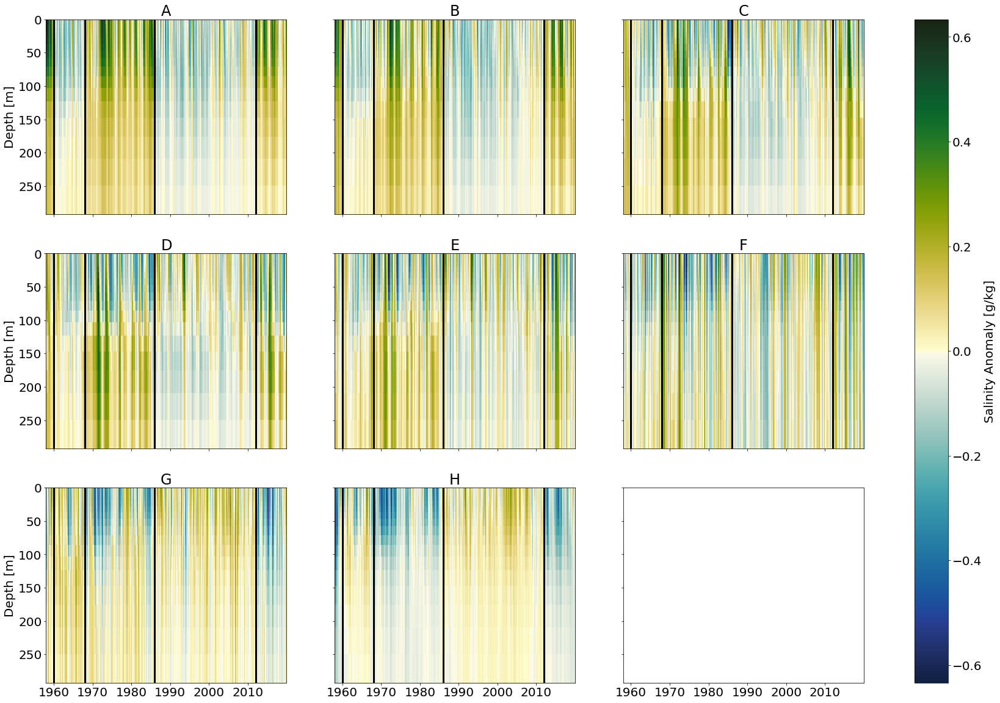

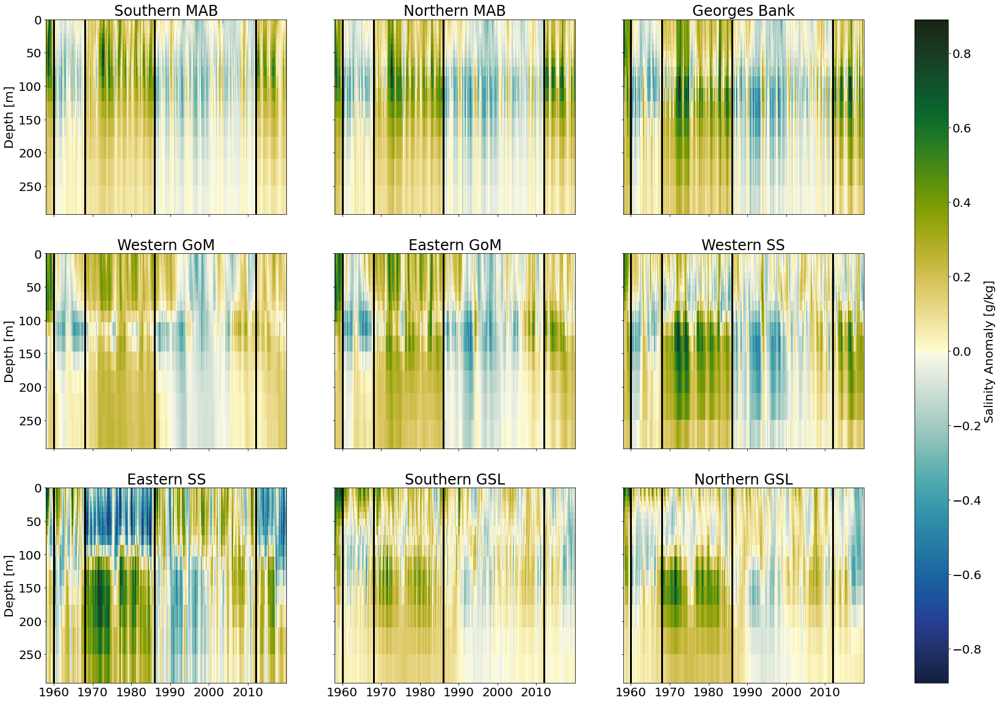

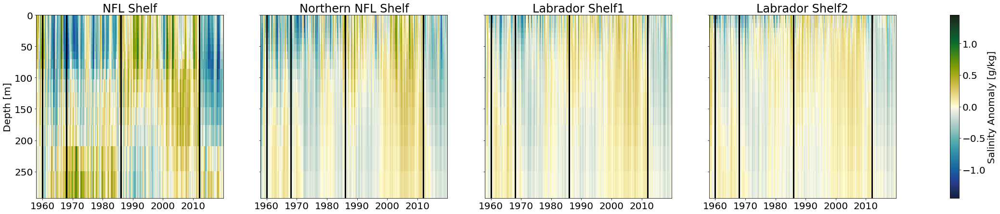

In [19]:
###### Plot Hovmoeller diagrams without seasonal cycles (Anomalies)
plt.rcParams['font.size'] = 20.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean2, axs_mean2 = plt.subplots(3, 3, figsize = (30,20), sharex = True, sharey = True)
fig_mean3, axs_mean3 = plt.subplots(1, 4, figsize = (40,7), sharex = True, sharey = True)

cmap = 'cmo.delta'

#Mean plots
i = 0
for ax in axs_mean1.flat:
    
    if i != 8:
    
         
        colorplot = ax.pcolormesh(sal_mean_anom[masks[i]].time_counter.values, sal_mean_anom[masks[i]].deptht,
                      sal_mean_anom[masks[i]]['vosaline'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)

        ax.set_title(masks[i])
        i += 1
        
        for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
        
axs_mean1[0][0].invert_yaxis()    

for ax in axs_mean1[:,0]:
    ax.set_ylabel('Depth [m]')


fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Salinity Anomaly [g/kg]', location = 'right')
    
for ax in axs_mean2.flat:
    
     
    colorplot = ax.pcolormesh(sal_mean_anom[masks[i]].time_counter.values, sal_mean_anom[masks[i]].deptht,
                  sal_mean_anom[masks[i]]['vosaline'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])

    for j in range(len(time_periods)):
        ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
    i += 1
    
axs_mean2[0][0].invert_yaxis()    

    
for ax in axs_mean2[:,0]:
    ax.set_ylabel('Depth [m]')
    
fig_mean2.colorbar(colorplot, ax = axs_mean2, label = 'Salinity Anomaly [g/kg]', location = 'right')

for ax in axs_mean3.flat:
    
     
    
    colorplot = ax.pcolormesh(sal_mean_anom[masks[i]].time_counter.values, sal_mean_anom[masks[i]].deptht,
                  sal_mean_anom[masks[i]]['vosaline'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)
    
    ax.set_title(masks[i])

    for j in range(len(time_periods)):
        ax.axvline(x = time_periods[j], color = 'black', linewidth = 3)
    i += 1
    
axs_mean3[0].set_ylabel('Depth [m]')
axs_mean3[0].invert_yaxis()    

fig_mean3.colorbar(colorplot, ax = axs_mean3, label = 'Salinity Anomaly [g/kg]', location = 'right')    
    
#Save Figures
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_anom1_{}.png'.format(depth))
fig_mean2.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_anom2_{}.png'.format(depth))
fig_mean3.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_anom3_{}.png'.format(depth))

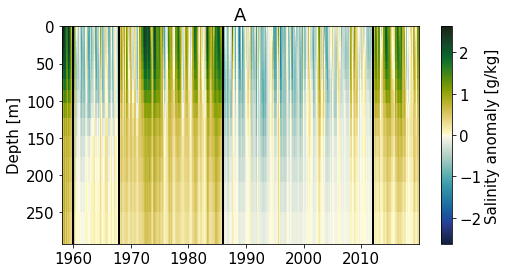

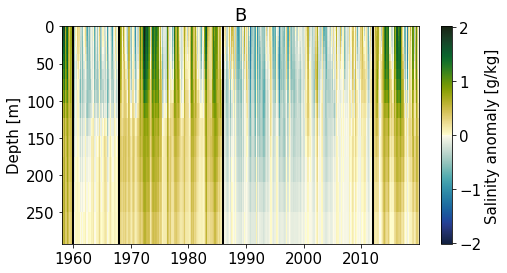

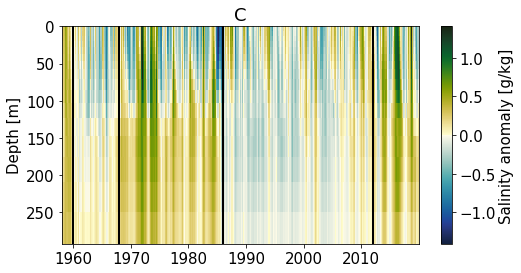

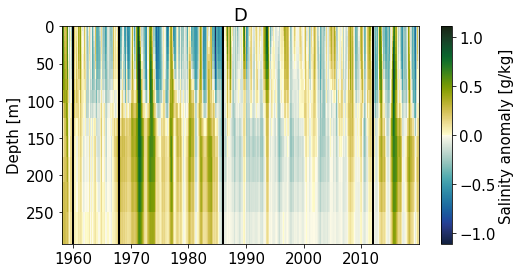

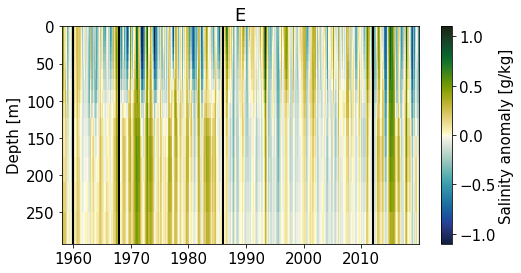

...

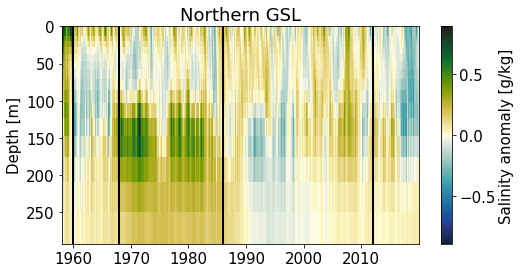

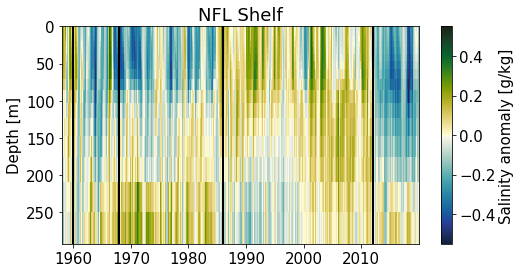

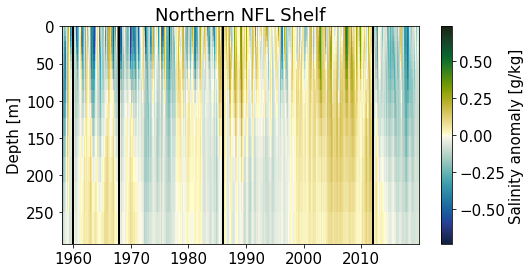

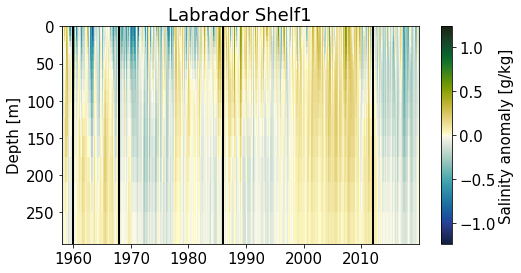

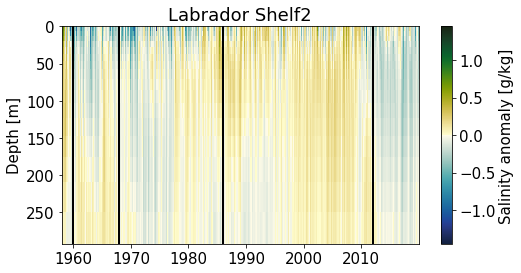

In [20]:
#Plots one by one without seasonal cycle
plt.rcParams['font.size'] = 15.0
cmap = 'cmo.delta'
for i in range(len(masks)):
    
    #Mean
    #Labels and Title
    fig1, ax1 = plt.subplots(figsize = (8,4))

    ax1.set_ylabel('Depth [m]')
    ax1.set_title(masks[i])

    #Actual Plot
    colorplot = ax1.pcolormesh(sal_mean_anom[masks[i]].time_counter.values, sal_mean_anom[masks[i]].deptht,
                  sal_mean_anom[masks[i]]['vosaline'].T, cmap = cmap, norm = colors.CenteredNorm())

    #Invert y-axis and add colorbar
    ax1.invert_yaxis()
    fig1.colorbar(colorplot, label = 'Salinity anomaly [g/kg]', cmap = cmap)
    
    #Add vlines for time period
    for j in range(len(time_periods)):
        ax1.axvline(x = time_periods[j], color = 'black', linewidth = 2)
    
    plt.show()
    #Save figure 
    fig1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/anom_' + masks[i] + '_{}.png'.format(depth))
    


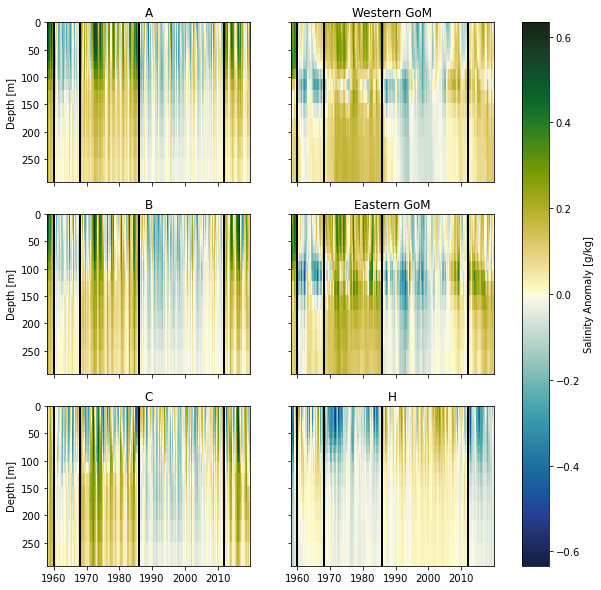

In [21]:
#Plot Hovmoeller diagrams without seasonal cycles (Anomalies) for chosen masks
plt.rcParams['font.size'] = 10.0

#Figures Mean
fig_mean1, axs_mean1 = plt.subplots(3, 2, figsize = (10,10), sharex = True, sharey = True)

#cmap - does not work yet
cmap = 'cmo.delta'
 
#Mean plots
i = 0
axs_mean1[0][0].invert_yaxis()    

for ax in axs_mean1.flat:
    
    if i != 8:
    
        #Labels and Title
         
        colorplot = ax.pcolormesh(sal_mean_anom[masks_reorder[i]].time_counter.values, sal_mean_anom[masks_reorder[i]].deptht,
                      sal_mean_anom[masks_reorder[i]]['vosaline'].T, cmap = cmap, norm = colors.CenteredNorm())#, vmin = 0, vmax = 23)

        ax.set_title(masks_reorder[i])
        i += 1
        for j in range(len(time_periods)):
            ax.axvline(x = time_periods[j], color = 'black', linewidth = 2)
        
for ax in axs_mean1[:,0]: 
    ax.set_ylabel('Depth [m]')

fig_mean1.colorbar(colorplot, ax = axs_mean1, label = 'Salinity Anomaly [g/kg]', location = 'right')
fig_mean1.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/HM/Sal/subplots_ABC45H_{}.png'.format(depth))   

# TS-Plots 

## Animation for arbitrary masks all years

<IPython.core.display.Javascript object>


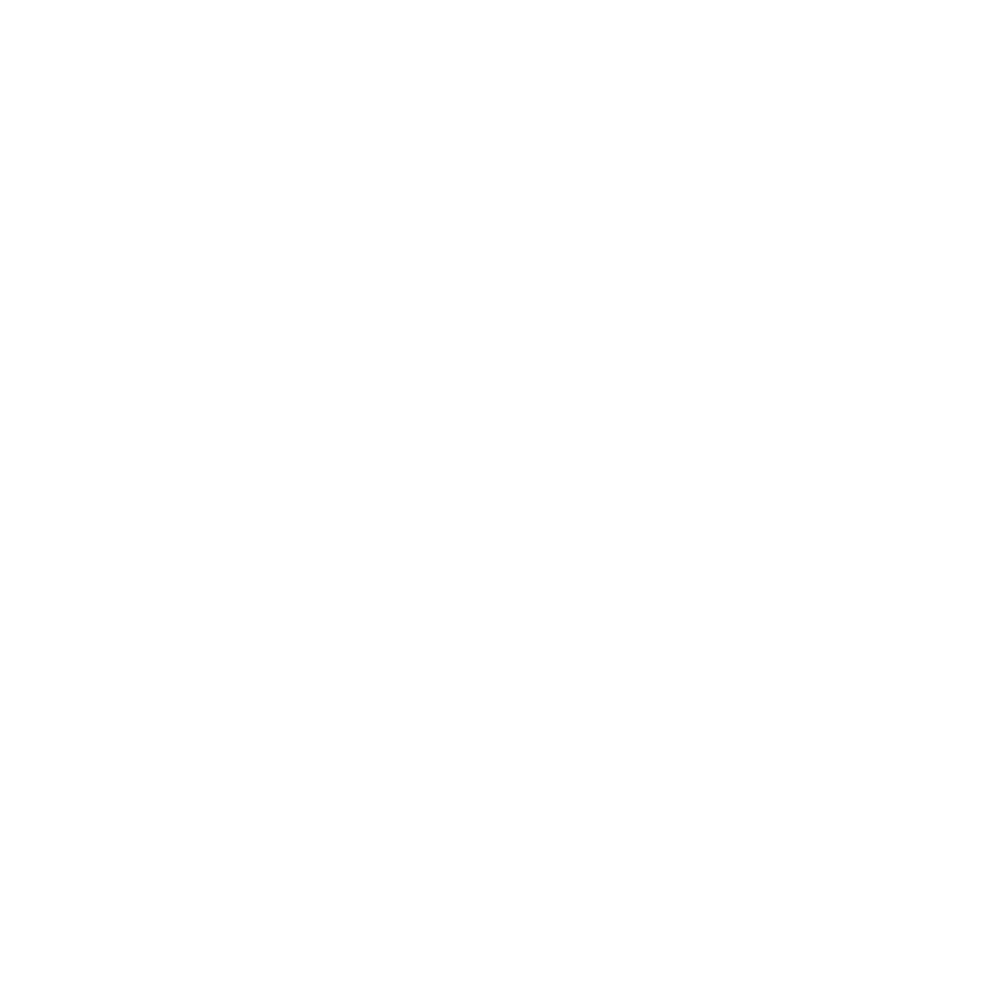

In [22]:
%matplotlib notebook

mask_choice = 'Western GoM'

#Salinity/Time Plot
plt.rcParams['font.size'] = 20.0

#Choose cmap
cmap = 'cmo.deep'

fig_sctt = plt.figure(figsize = (8,8))
ax_sctt = plt.axes(xlim = [31, 40], ylim = [0, 25])

plt.xlabel('Salinity [g/kg]')
plt.ylabel('Temperature [°C]')
plt.grid()

#Animation counting up all years
line = ax_sctt.scatter(sal_mean[mask_choice]['vosaline'][0], temp_mean[mask_choice]['votemper'][0], c = temp_mean[mask_choice]['deptht'], cmap = cmap)#, color = 'black')
cbar = plt.colorbar(line, label = 'Depth [m]')
cbar.ax.invert_yaxis()

def animate(i):
    
    line.set_offsets(np.c_[sal_mean[mask_choice]['vosaline'][i], temp_mean[mask_choice]['votemper'][i]])
    plt.title(np.datetime_as_string(temp_mean[mask_choice]['time_counter'][i].to_numpy(), unit = 'M'))

    
# anim = FuncAnimation(fig_sctt, animate, init_func = init, frames = 200, interval = 20, blit = True)
anim = FuncAnimation(fig_sctt, animate, frames = 744, interval = 500, blit = False)

#Save Animation as gif
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/all_' + mask_choice + '_{}.gif'.format(depth), writer='imagemagick', fps=10)

## Animation for seasonal cycle

<IPython.core.display.Javascript object>


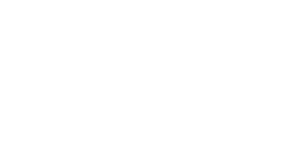

In [23]:
%matplotlib notebook

#Animation of seasonal cycle
plt.rcParams['font.size'] = 20.0

#Months
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Okt', 'Nov', 'Dec']

#Choose cmap
cmap = 'cmo.deep'

fig_sctt_sea = plt.figure(figsize = (8,8))
ax_sctt_sea = plt.axes(xlim = [30, 36], ylim = [0, 20])

plt.xlabel('Salinity [g/kg]')
plt.ylabel('Temperature [°C]')
plt.grid()

#Animation counting up all years
line_sea = ax_sctt_sea.scatter(sal_mon[mask_choice]['vosaline'][0], temp_mon[mask_choice]['votemper'][0], c = temp_mon[mask_choice]['deptht'], cmap = cmap)#, color = 'black')
cbar = plt.colorbar(line_sea, label = 'Depth [m]')
cbar.ax.invert_yaxis()

def animate(i):
    
    line_sea.set_offsets(np.c_[sal_mon[mask_choice]['vosaline'][i], temp_mon[mask_choice]['votemper'][i]])
    plt.title(months[i])
    
# anim = FuncAnimation(fig_sctt, animate, init_func = init, frames = 200, interval = 20, blit = True)
anim = FuncAnimation(fig_sctt_sea, animate, frames = 12, interval = 1000, blit = False)

#Save Animation as gif
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/seas_cyc_' + mask_choice + '_{}.gif'.format(depth), writer='imagemagick', fps=1)

## TS time-mean plot

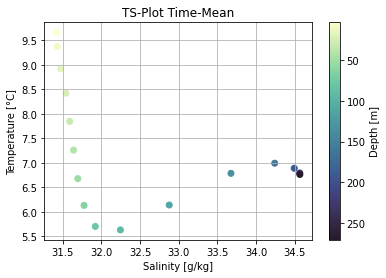

In [24]:
%matplotlib inline
#TS Plot for time-mean

#Choose cmap
cmap = 'cmo.deep'

plt.close('all')
#Title and labels
fig_TS_mean = plt.figure()
plt.title('TS-Plot Time-Mean')
plt.xlabel('Salinity [g/kg]')
plt.ylabel('Temperature [°C]')
plt.grid()

sctt = plt.scatter(sal_mean[mask_choice]['vosaline'].mean(dim = 'time_counter'), temp_mean[mask_choice]['votemper'].mean(dim = 'time_counter'), c = temp_mean[mask_choice].deptht, cmap = cmap)
cbar = plt.colorbar(sctt, label = 'Depth [m]') 
cbar.ax.invert_yaxis()

fig_TS_mean.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/time_mean_' + mask_choice + '_{}.png'.format(depth))

## Animation TS-anomalies

<IPython.core.display.Javascript object>


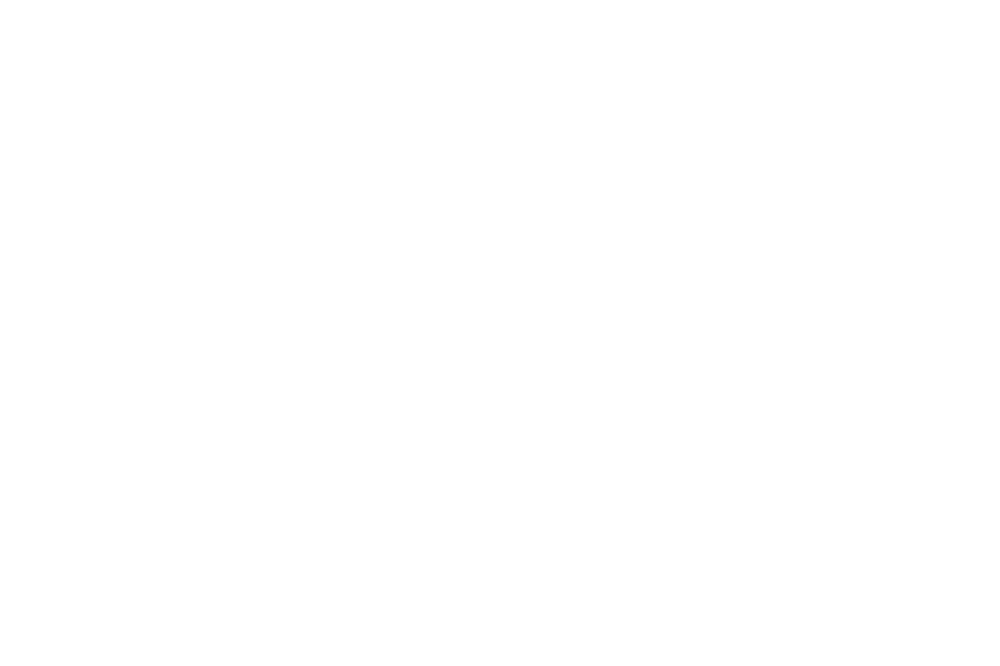

In [25]:
%matplotlib notebook

#Salinity/Time Plot
plt.rcParams['font.size'] = 20.0

#Choose cmap
cmap = 'cmo.deep'

fig_sctt2 = plt.figure(figsize = (12,8))
ax_sctt2 = plt.axes(xlim = [-2, 2], ylim = [-2.5, 2.5])

plt.xlabel('Salinity Anomaly [g/kg]')
plt.ylabel('Temperature Anomaly [°C]')
plt.grid()

#Animation counting up all years
line_wo_seas = ax_sctt2.scatter(sal_mean_anom[mask_choice]['vosaline'][0], temp_mean_anom[mask_choice]['votemper'][0], c = temp_mean_anom[mask_choice]['deptht'], cmap = cmap)#, color = 'black')
cbar = plt.colorbar(line_wo_seas, label = 'Depth [m]')
cbar.ax.invert_yaxis()

def animate3(i):
    
    line_wo_seas.set_offsets(np.c_[sal_mean_anom[mask_choice]['vosaline'][i], temp_mean_anom[mask_choice]['votemper'][i]])
    plt.title(np.datetime_as_string(temp_mean_anom[mask_choice]['time_counter'][i].to_numpy(), unit = 'M'))

    
# anim = FuncAnimation(fig_sctt2, animate, init_func = init, frames = 200, interval = 20, blit = True)
anim = FuncAnimation(fig_sctt2, animate3, frames = 744, interval = 500, blit = False)

#Save Animation as gif
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/all_without_seas_' + mask_choice + '_{}.gif'.format(depth), writer='imagemagick', fps=10)

## Time-mean each period

In [26]:
#Delete masks where decadal variability was not visible
#Useful list of string with mask names 
masks_rm = ['A', 'B', 'C', 'D', 'E', 'Southern MAB', 'Northern MAB',
         'Georges Bank', 'Western GoM', 'Eastern GoM', 'Western SS', 
         'Eastern SS', 'Southern GSL', 'Northern GSL']
time_periods = ['1960', '1968', '1986', '2012', '2019']


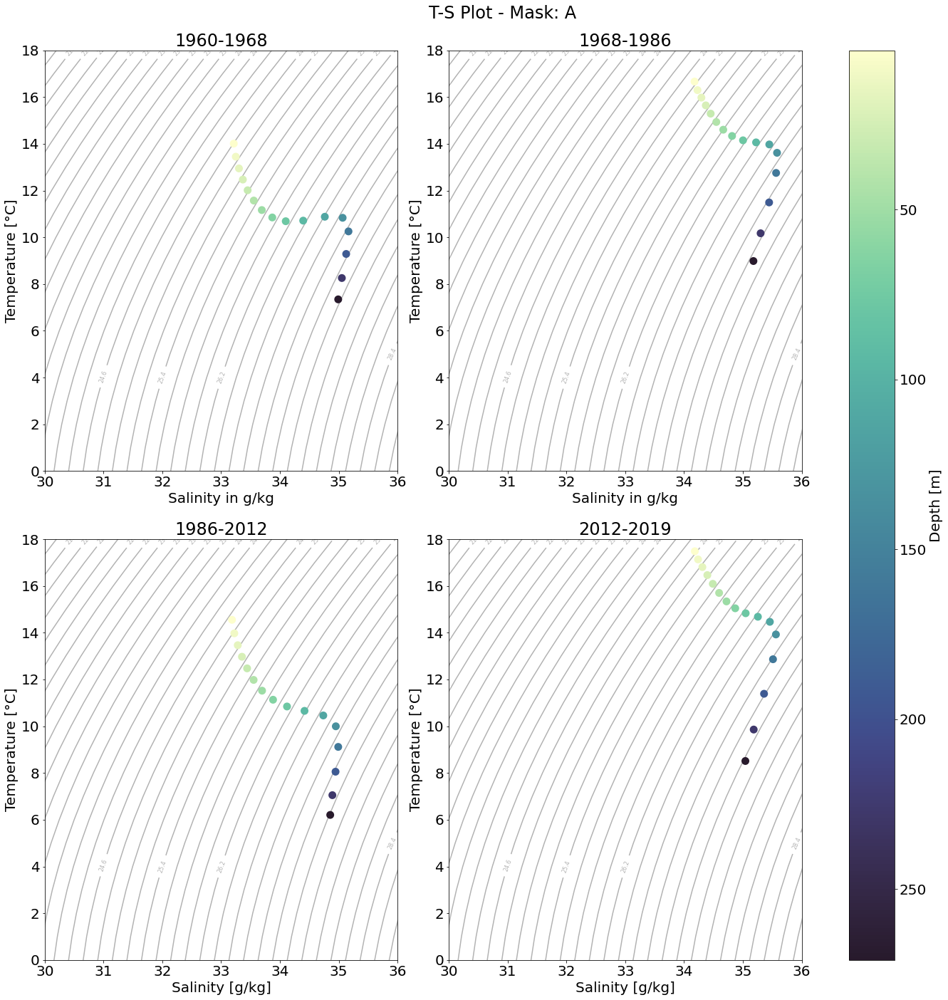

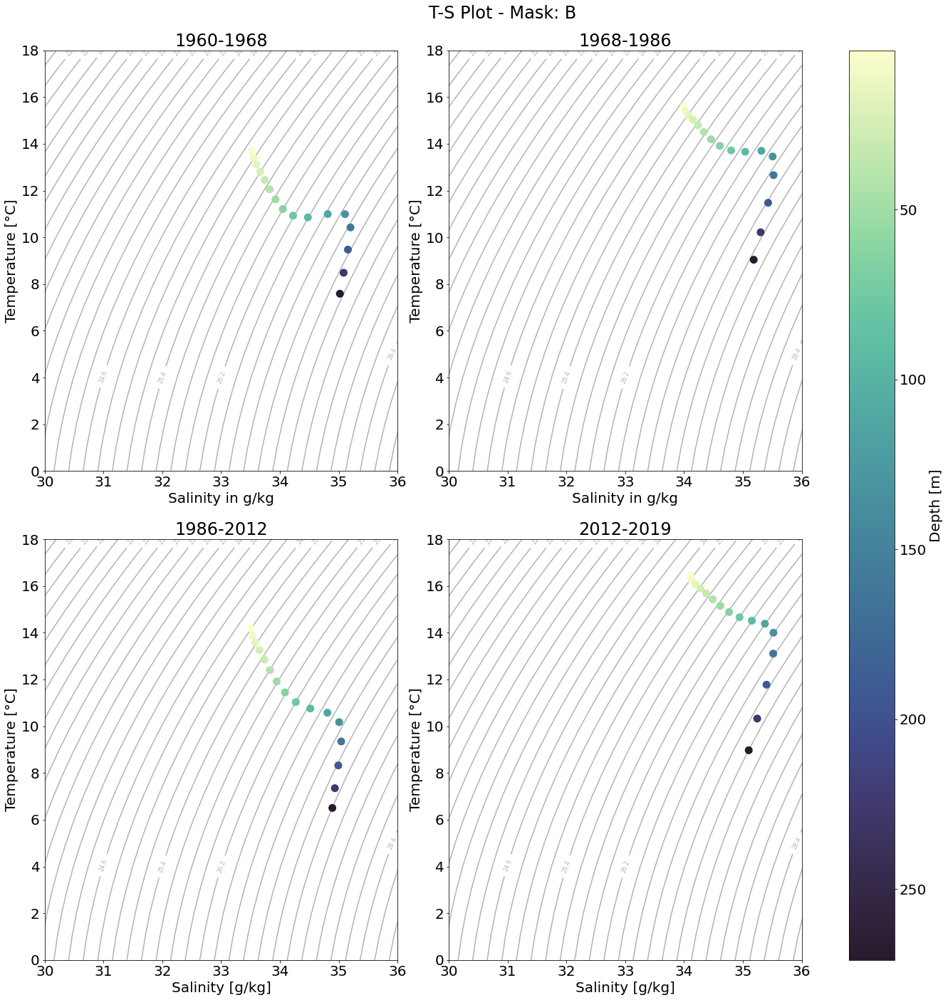

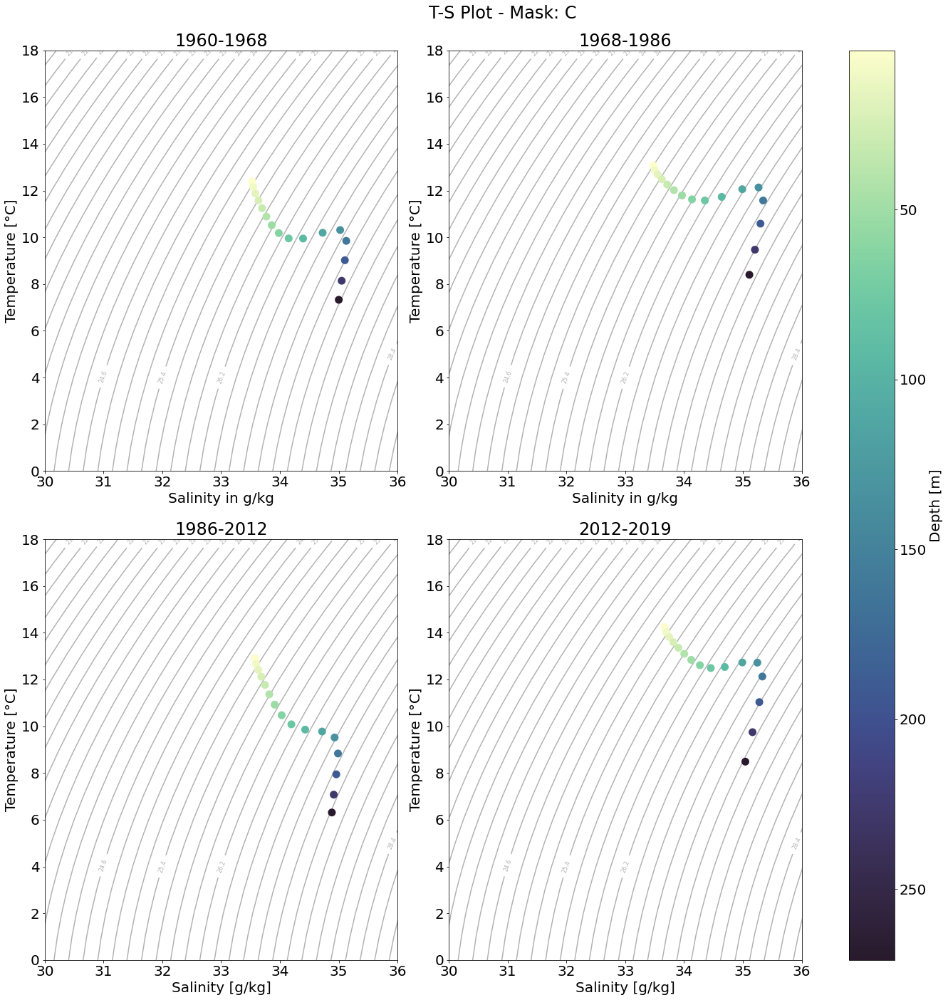

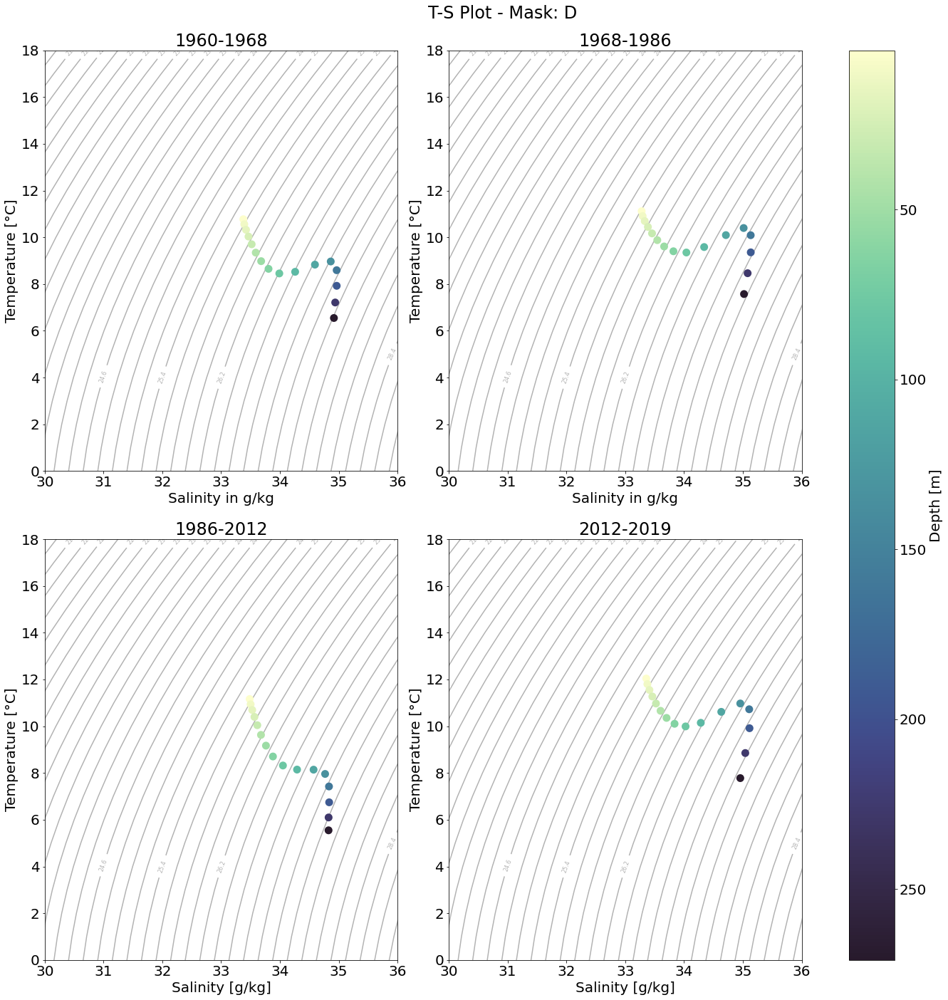

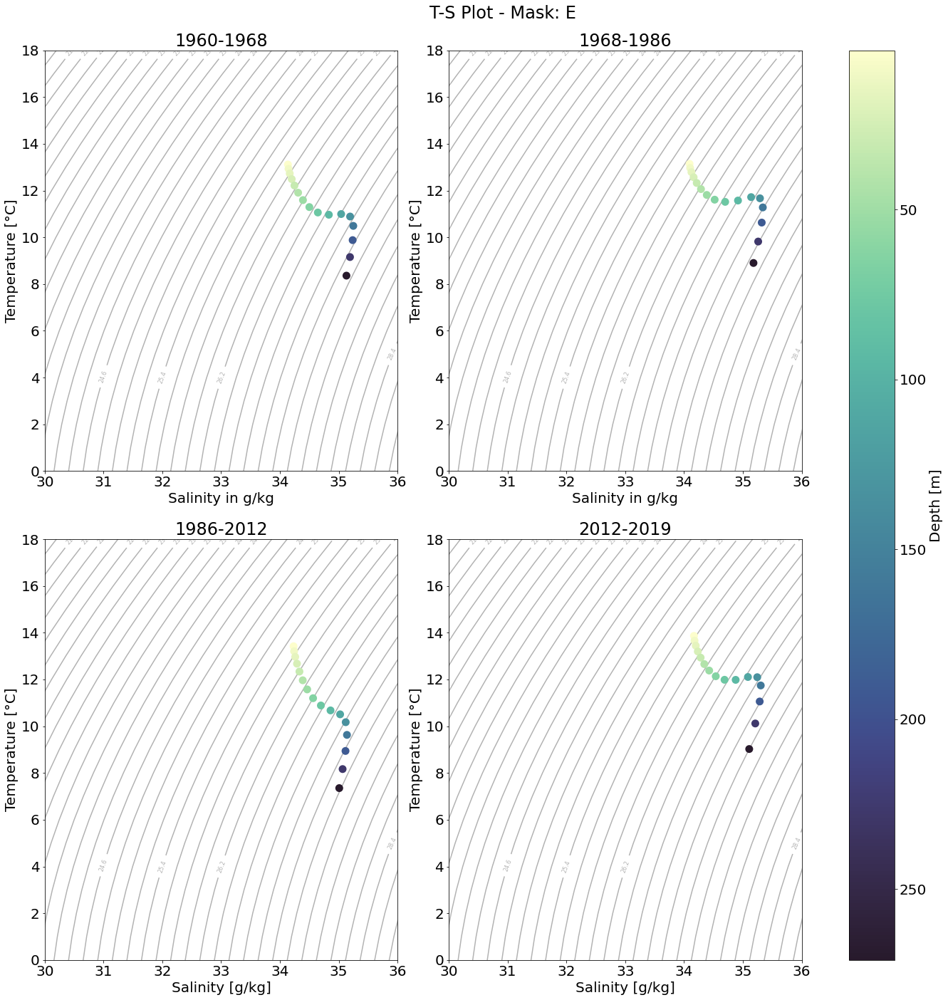

...

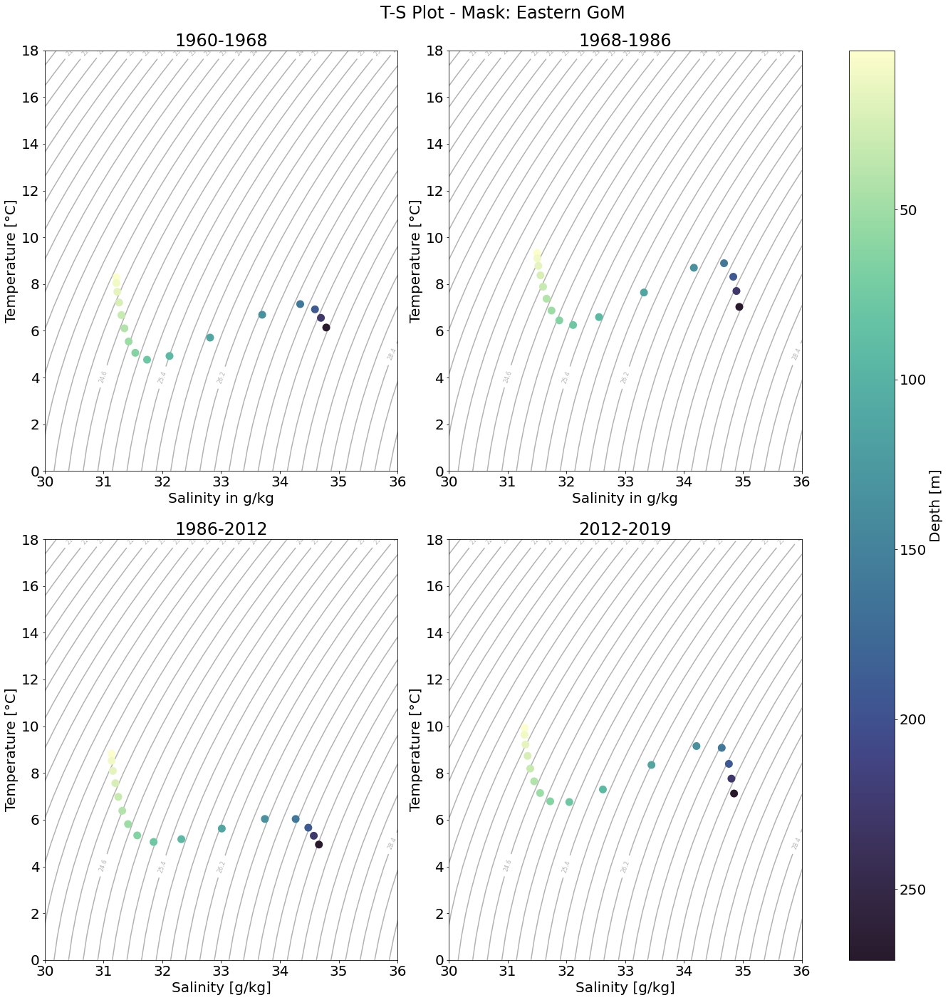

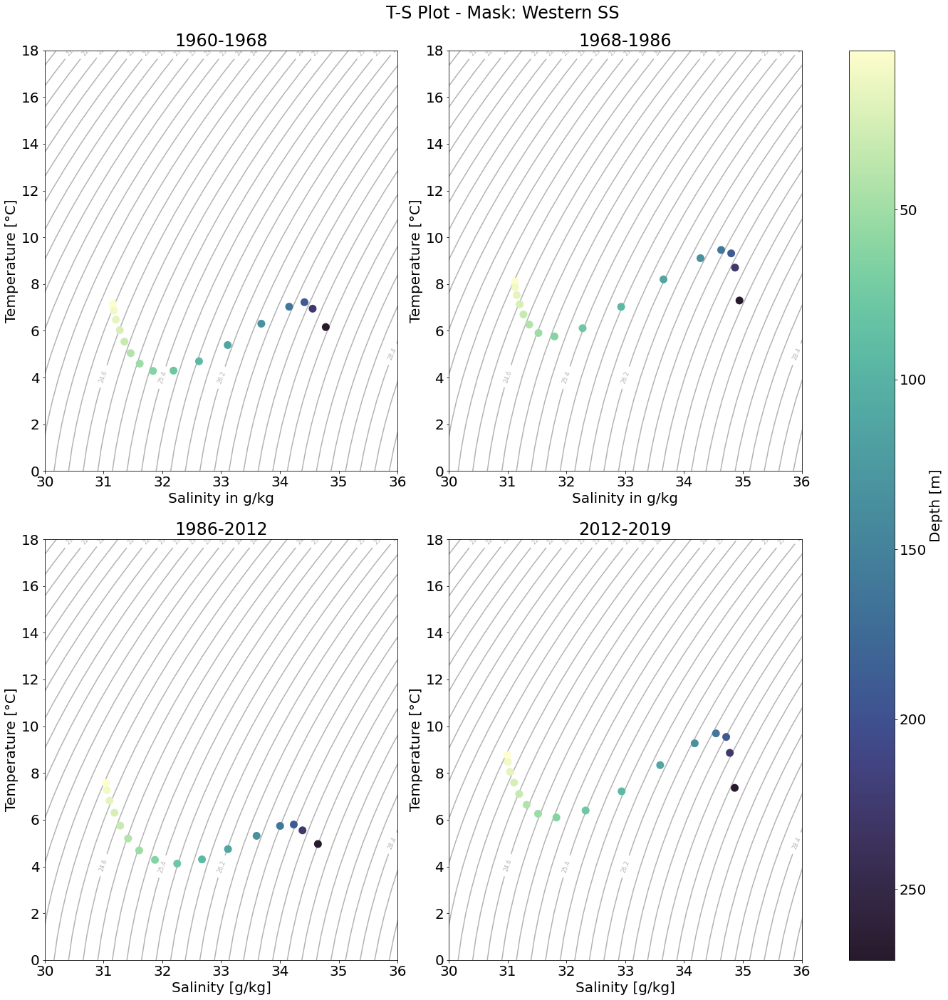

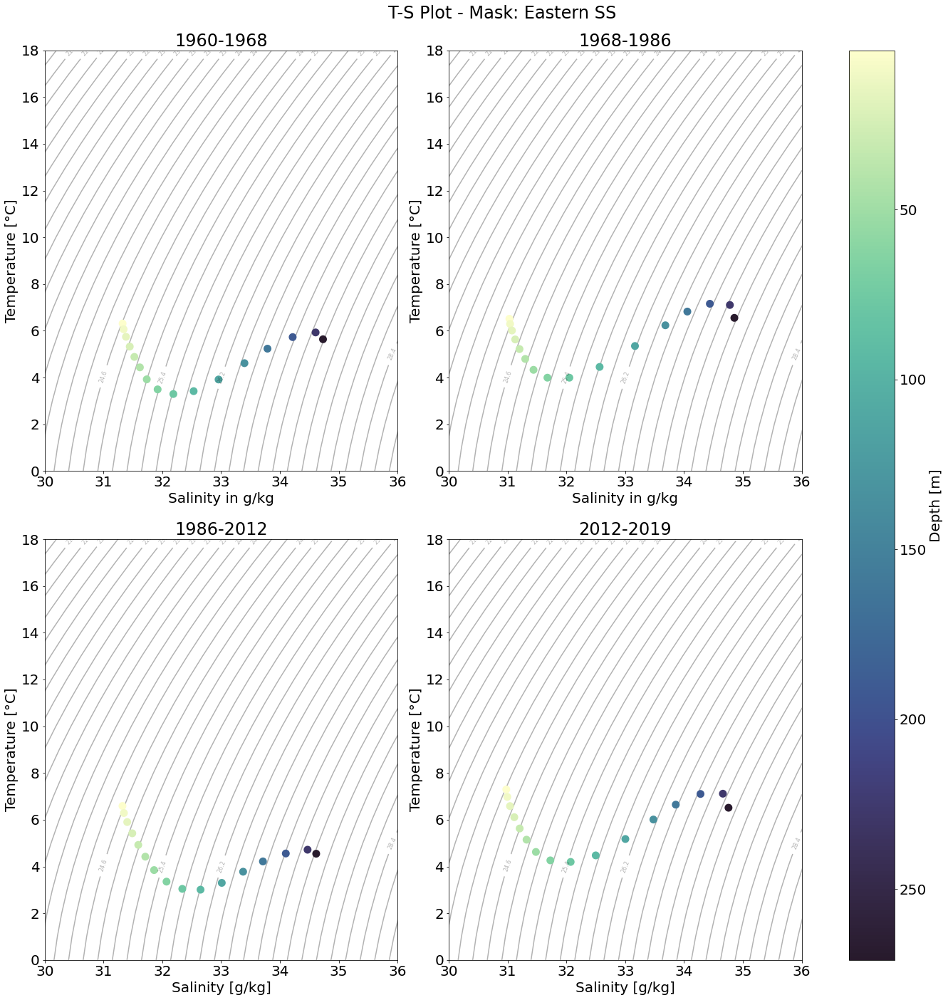

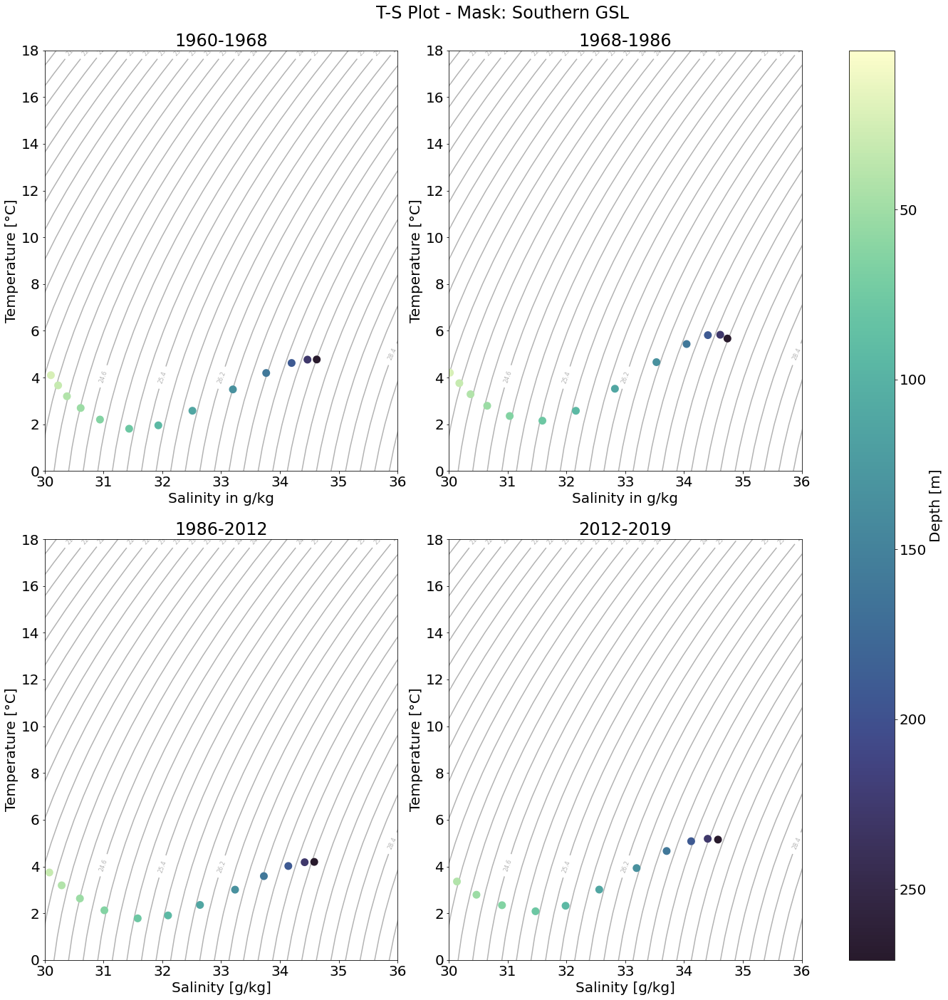

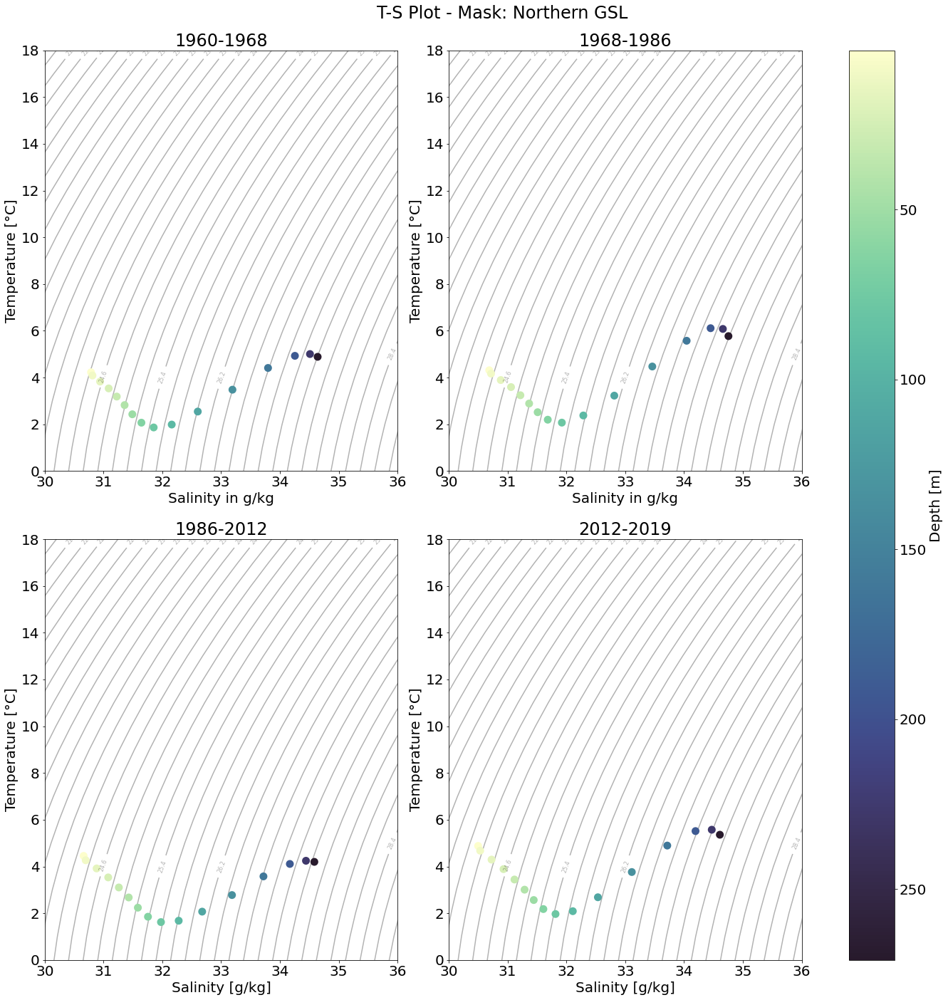

In [27]:
%matplotlib inline

#Do T-S-Plots for mean 
#Calculate time mean for each time period
temp_periods_mean = {}
sal_periods_mean = {}
for i in range(len(masks_rm)):
    for j in range(len(time_periods) - 1):
        temp_periods_mean[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = temp_mean[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1])).mean(dim = 'time_counter')
        sal_periods_mean[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = sal_mean[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1])).mean(dim = 'time_counter')

#Choose colormap
cmap = 'cmo.deep'

#Adjust font size
plt.rcParams['font.size'] = 20.0

for i in range(len(masks_rm)):
    fig, axs = plt.subplots(2, 2, figsize = (20,20))#, sharex = True, sharey = True)
    
    j = 0
    for ax in axs.flat:
        ax.set_xlim([30, 36])
        ax.set_ylim([0, 17.5])
        sctt = ax.scatter(sal_periods_mean[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                          temp_periods_mean[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                          c = sal_periods_mean[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['deptht'],
                          cmap = cmap, linewidth = 5)
        
        ax.set_title(time_periods[j] + '-' + time_periods[j+1])
        j += 1
        ts_append(levels = 100, axh = ax)
        
        
    fig.suptitle('T-S Plot - Mask: ' + masks_rm[i])
    fig.tight_layout()
    
    for ax in axs[:,0]:
        ax.set_ylabel('Temperature [°C]')
        
    for ax in axs[1,:]:
        ax.set_xlabel('Salinity [g/kg]')
        
    cbar = fig.colorbar(sctt, ax = axs, label = 'Depth [m]', location = 'right') 
    cbar.ax.invert_yaxis()
    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/periods_mean_' + masks_rm[i] + '_{}.png'.format(depth))

## Each point in time

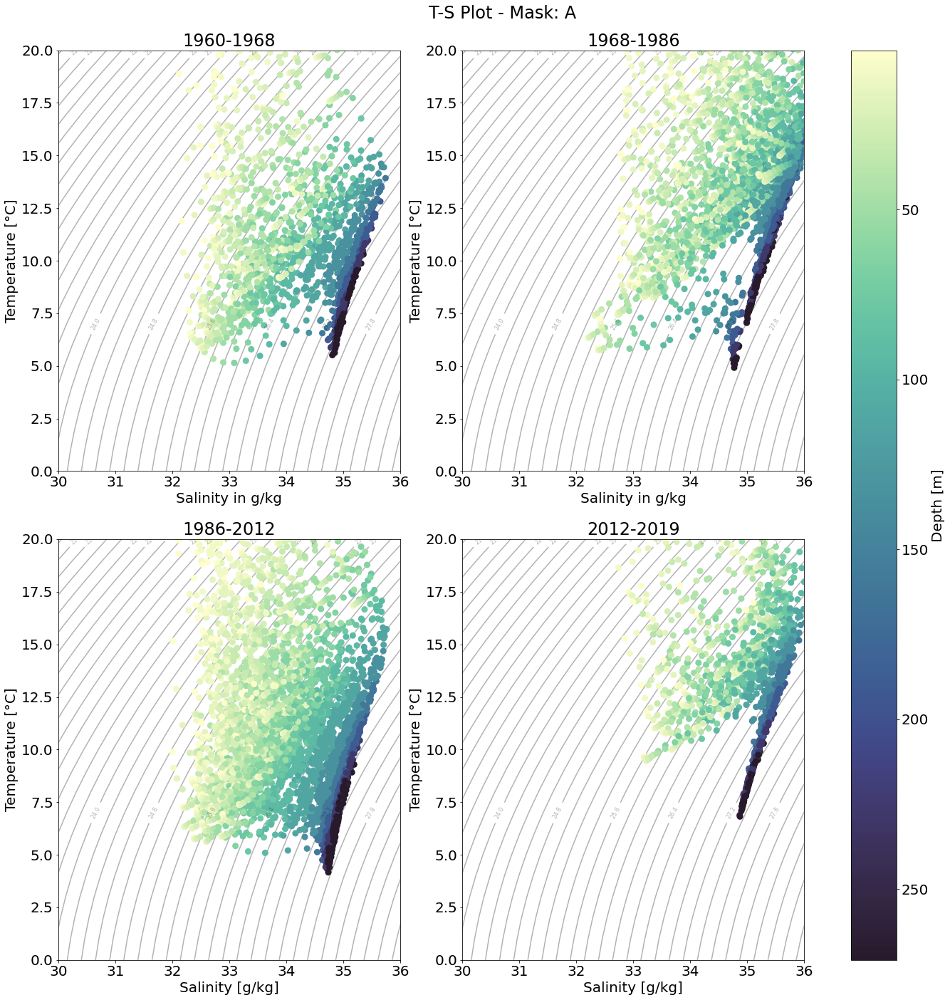

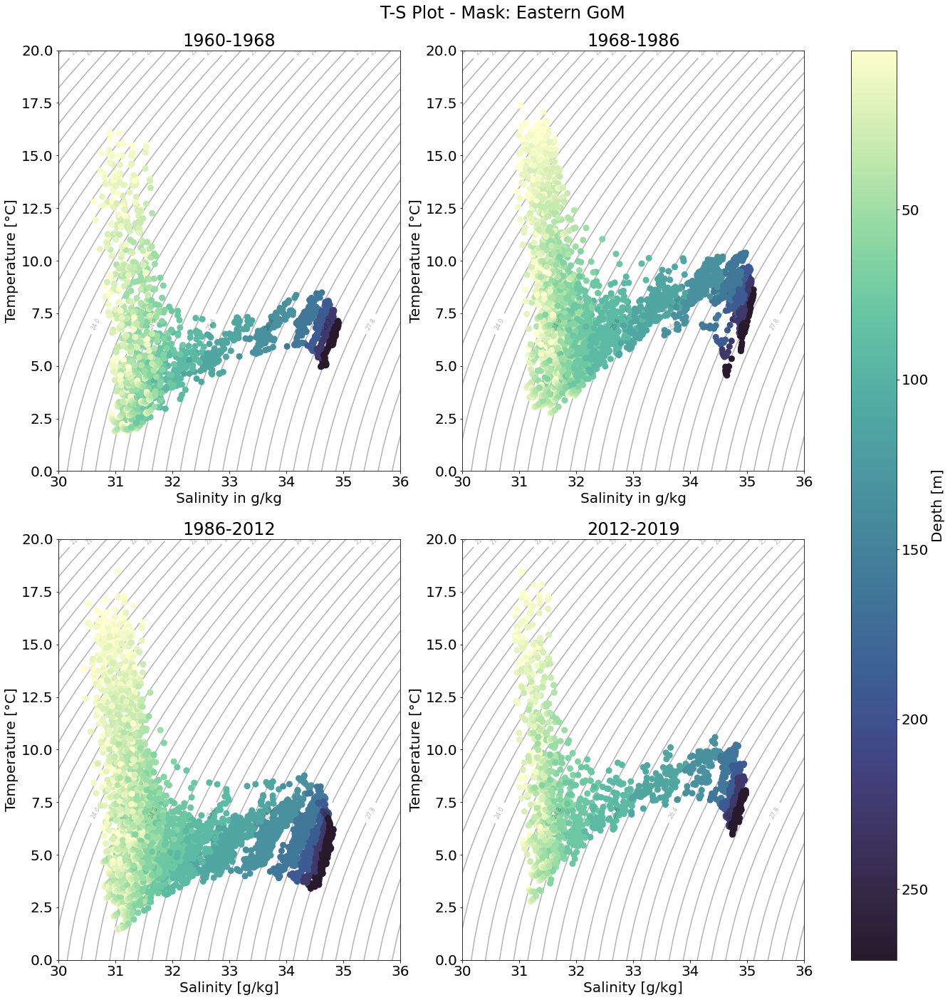

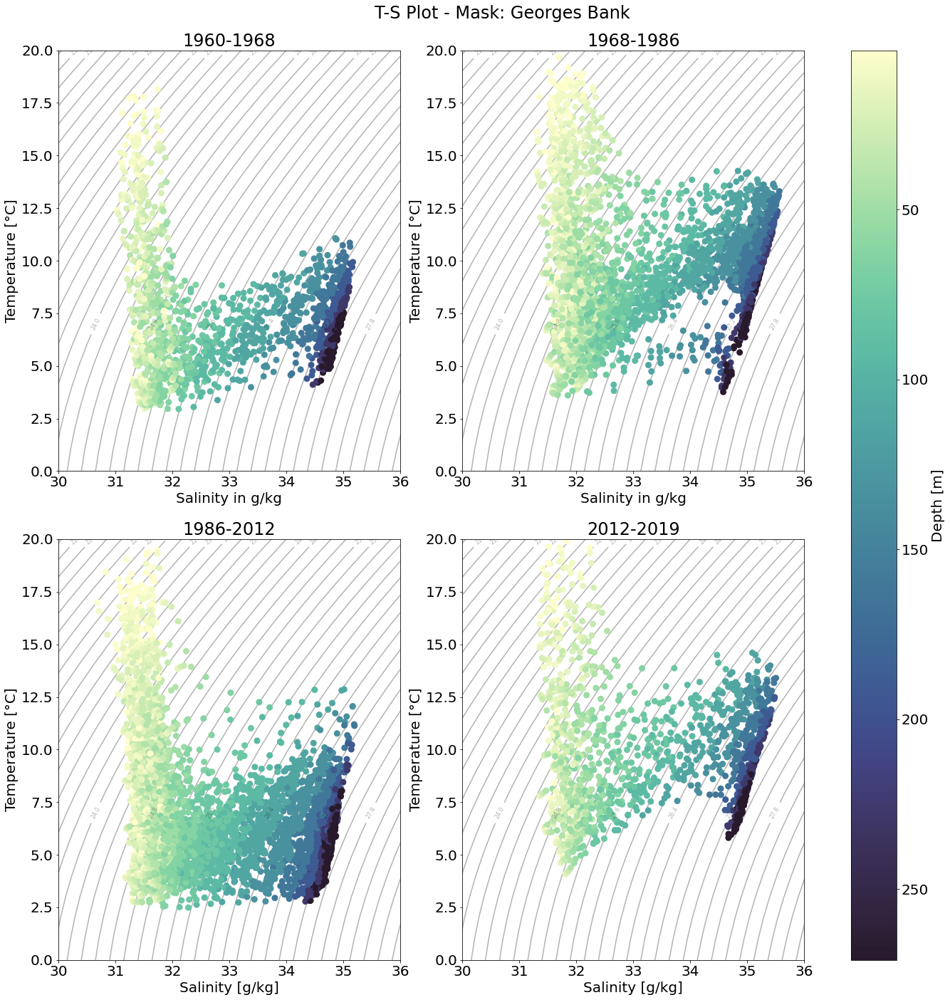

In [28]:
%matplotlib inline
#Do T-S-Plots for each point in time 

#Adjust font size
plt.rcParams['font.size'] = 20.0

temp_periods = {}
sal_periods = {}
for i in range(len(masks_rm)):
    for j in range(len(time_periods) - 1):
        temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = temp_mean[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1]))
        sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = sal_mean[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1]))

#Choose physical property to be shaded; 0: Depth; 1: Temperature; 2: Salinity
shading = 0

#Reduce eventually number of displayed masks_rm
masks_rm = ['A', 'Eastern GoM', 'Georges Bank']

for i in range(len(masks_rm)):
    fig, axs = plt.subplots(2, 2, figsize = (20,20))#, sharex = True, sharey = True)
    
    j = 0
    for ax in axs.flat:
        ax.set_xlim([30, 35.5])
        ax.set_ylim([0, 20])
        if shading == 0:
        
            depth_color = np.ones((len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline']),
                                   len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['deptht'])))

            for k in range(len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'])):
                depth_color[k] = sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['deptht']

            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = depth_color, 
                              cmap = 'cmo.deep', linewidth = 3)
            label = 'Depth [m]'
            
        elif shading == 1:
            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'], 
                              cmap = 'cmo.thermal', linewidth = 3)
            label = 'Temperature [°C]'
            
        elif shading == 2: 
            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'], 
                              cmap = 'cmo.haline', linewidth = 3)
            label = 'Salinity [g/kg]'
            
        ax.set_title(time_periods[j] + '-' + time_periods[j+1])
        j += 1
        ts_append(levels = 100, axh = ax)
        
        
    fig.suptitle('T-S Plot - Mask: ' + masks_rm[i])
    fig.tight_layout()
    
    for ax in axs[:,0]:
        ax.set_ylabel('Temperature [°C]')
        
    for ax in axs[1,:]:
        ax.set_xlabel('Salinity [g/kg]')
        
    cbar = fig.colorbar(sctt, ax = axs, label = label, location = 'right') 
    if shading == 0:
        cbar.ax.invert_yaxis()
    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/periods_all_' + masks_rm[i] + '_{}.png'.format(depth))

## Anomalies

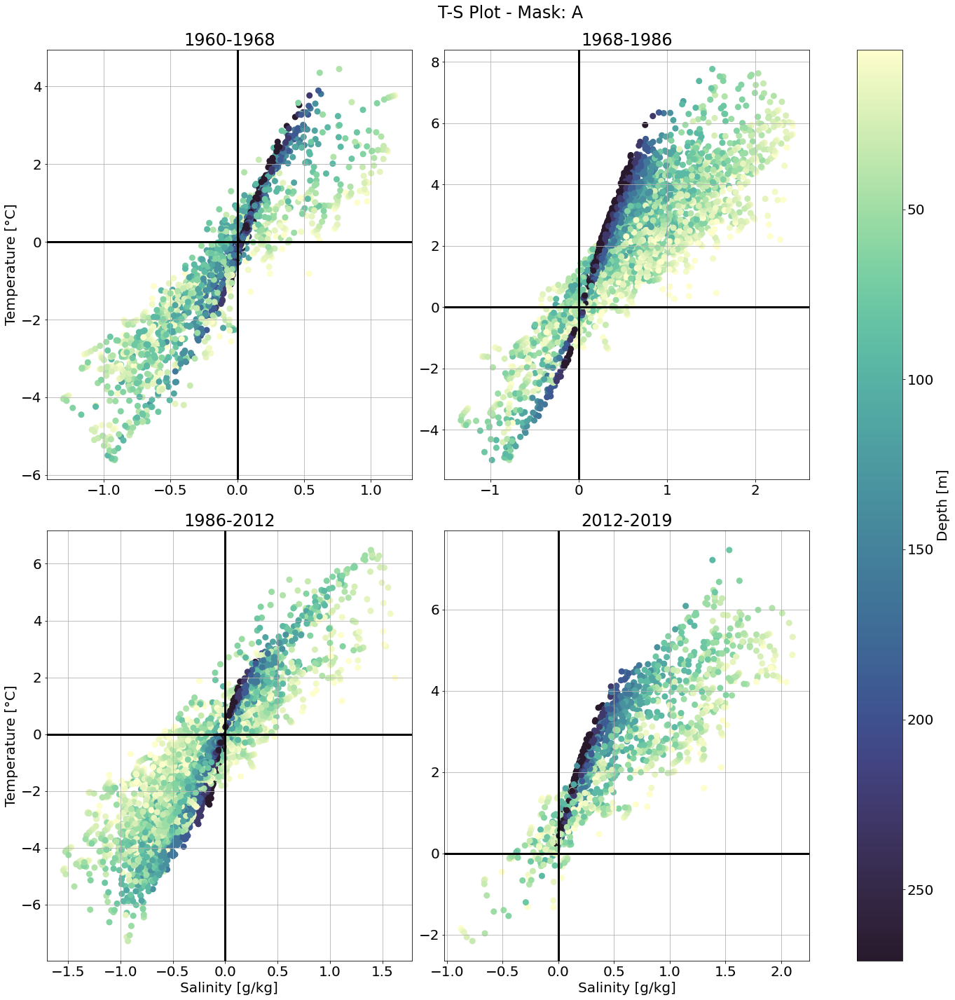

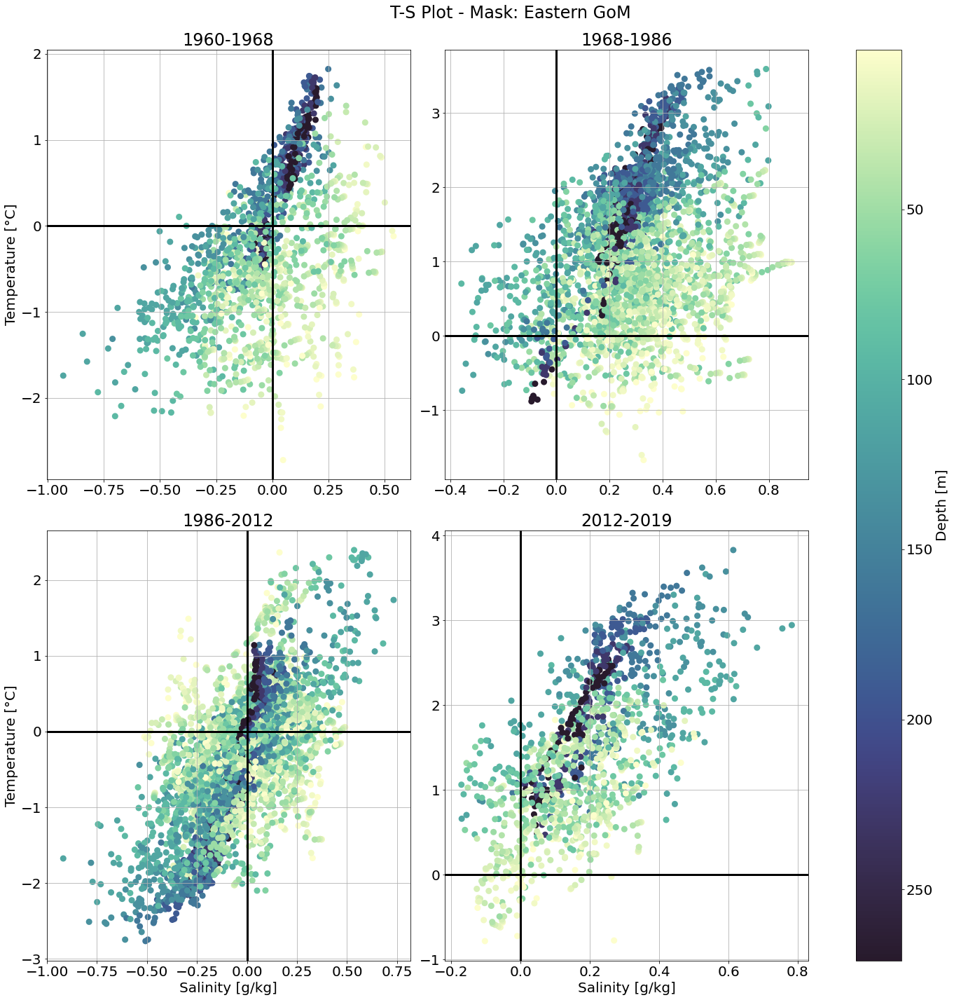

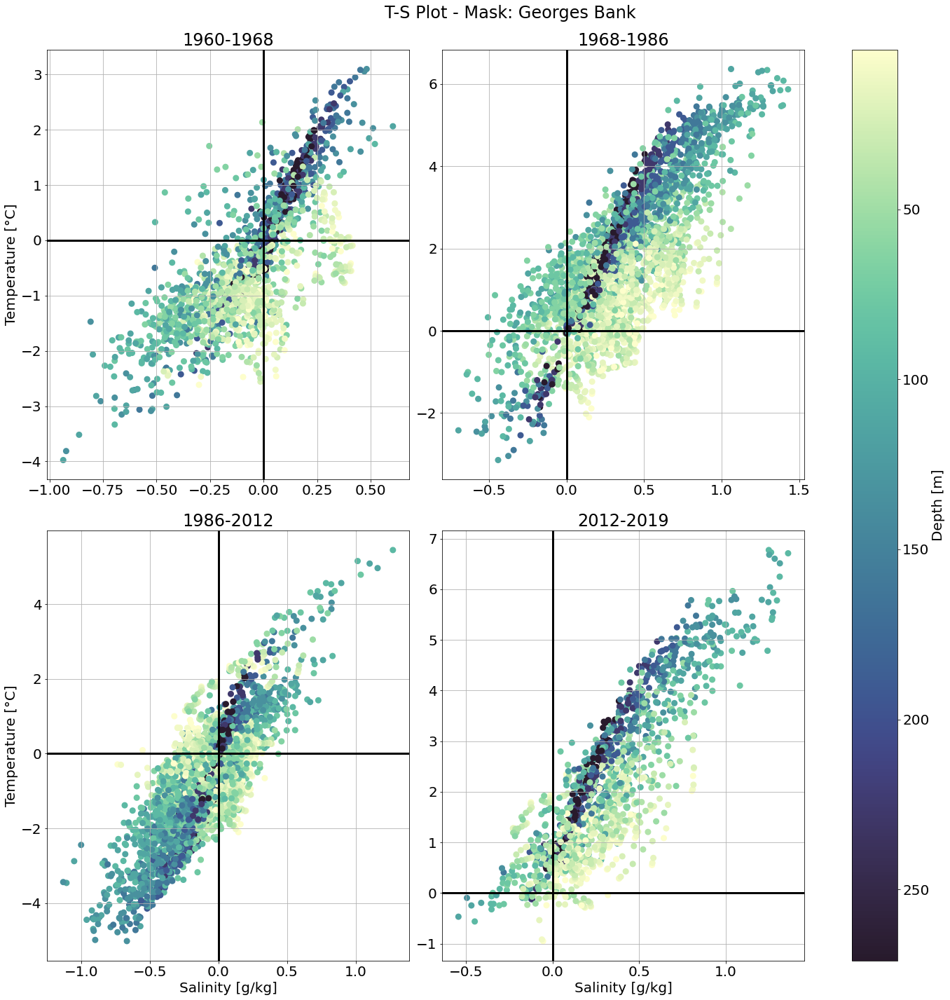

In [29]:
%matplotlib inline
#Now do the same for anomalies

#Adjust font size
plt.rcParams['font.size'] = 20.0

temp_periods = {}
sal_periods = {}
for i in range(len(masks_rm)):
    for j in range(len(time_periods) - 1):
        temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = temp_mean_anom[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1]))
        sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = sal_mean_anom[masks_rm[i]].sel(time_counter = slice(time_periods[j], time_periods[j+1]))


for i in range(len(masks_rm)):
    fig, axs = plt.subplots(2, 2, figsize = (20,20))#, sharex = True, sharey = True)
    
    j = 0
    for ax in axs.flat:
        #ax.set_xlim([30, 36])
        #ax.set_ylim([2, 22])
        ax.axvline(x = 0, linewidth = 3, color = 'black')
        ax.axhline(y = 0, linewidth = 3, color = 'black')
        if shading == 0:
        
            depth_color = np.ones((len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline']),
                                   len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['deptht'])))

            for k in range(len(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'])):
                depth_color[k] = sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['deptht']

            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = depth_color, 
                              cmap = 'cmo.deep', linewidth = 3)
            label = 'Depth [m]'
            
        elif shading == 1:
            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'], 
                              cmap = 'cmo.thermal', linewidth = 3)
            label = 'Temperature [°C]'
            
        elif shading == 2: 
            sctt = ax.scatter(sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'],
                              temp_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['votemper'],
                              c = sal_periods[masks_rm[i] + ':' + time_periods[j] + '-' + time_periods[j+1]]['vosaline'], 
                              cmap = 'cmo.haline', linewidth = 3)
            label = 'Salinity [g/kg]'
            
        ax.set_title(time_periods[j] + '-' + time_periods[j+1])
        j += 1
        
        ax.grid()
        
        
    fig.suptitle('T-S Plot - Mask: ' + masks_rm[i])
    fig.tight_layout()
    
    for ax in axs[:,0]:
        ax.set_ylabel('Temperature [°C]')
        
    for ax in axs[1,:]:
        ax.set_xlabel('Salinity [g/kg]')
        
    cbar = fig.colorbar(sctt, ax = axs, label = label, location = 'right') 
    if shading == 0:
        cbar.ax.invert_yaxis()
    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Spatial_Av/TS/periods_anom_' + masks_rm[i] + '.png'.format(depth))
